### Seasonality removal, Clustering
Try: Clustering on winter and summer seperatly. weenends, holidsays
DTW Dynamic Time Warping

In [197]:
API_KEY = "qLDLl62Fin7MWF17ApeJYhz17sPqUyTf"

In [ ]:
"""
id                                description  \
0    4868                   4531e0a Uilenstede 5-461   
1    4902          4531g0b Uilenstede 5-61 (Toren 1)   
2    4903       4534g0b Uilenstede 155-211 (Toren 2)   
3    4904       4535g0b Uilenstede 405-461 (Toren 3)   
4    4905                 4520g0a Uilenstede 106-460   
5   24584                   4501e0a Uilenstede 2-460   
6   40752                   4504g0a UIlenstede 36-70   
7   40773                    4501g0a Uilenstede 2-32   
8   40812          4511g0b Uilenstede 102 e-h (trad)   
9   41574        4510g0b Uilenstede 102 a-d (H-inst)   
10  55788       4534e9b Uilenstede 155-211 (WKK BPM)   
11  55789       4535e9b Uilenstede 405-461 (WKK BPM)   
12  55790          4531e9b Uilenstede 5-61 (WKK BPM)   
13  55791  4525e9a Uilenstede 106-422 wkk3 (WKK BPM)   
14  55792  4525e9a Uilenstede 106-422 wkk2 (WKK BPM)   
15  55793  4525e9a Uilenstede 106-422 wkk1 (WKK BPM)   
16  55885            4526e9b Uilenstede 108 (PV BPM)   
17  55886        4525e9b Uilenstede 280-422 (PV BPM)   
18  55891        4511e9b Uilenstede 102 e-h (PV BPM)   
19  55892        4510e9b Uilenstede 102 a-d (PV BPM)   
20  55893        4538e9b Uilenstede 500-502 (PV BPM)   
21  55894        4525e9b Uilenstede 280-422 (PV BPM)   
22  55895        4538e9b Uilenstede 500-502 (PV BPM)   
23  76861           4531e9b Uilenstede 5-61 (PV BPM)   
24  76862        4534e9b Uilenstede 155-211 (PV BPM)   
25  76863        4535e9b Uilenstede 405-461 (PV BPM) """

In [5]:
ids_and_descriptions_electric = {
    4868: '4531e0a Uilenstede 5-461',
    24584: '4501e0a Uilenstede 2-460',
    55788: '4534e9b Uilenstede 155-211 (WKK BPM)',
    55789: '4535e9b Uilenstede 405-461 (WKK BPM)',
    55790: '4531e9b Uilenstede 5-61 (WKK BPM)',
    55791: '4525e9a Uilenstede 106-422 wkk3 (WKK BPM)',
    55792: '4525e9a Uilenstede 106-422 wkk2 (WKK BPM)',
    55793: '4525e9a Uilenstede 106-422 wkk1 (WKK BPM)',
}
ids_and_descriptions_electric_pv = {    
    55885: '4526e9b Uilenstede 108 (PV BPM)',
    55886: '4525e9b Uilenstede 280-422 (PV BPM)',
    55891: '4511e9b Uilenstede 102 e-h (PV BPM)',
    55892: '4510e9b Uilenstede 102 a-d (PV BPM)',
    55893: '4538e9b Uilenstede 500-502 (PV BPM)',
    55894: '4525e9b Uilenstede 280-422 (PV BPM)',
    55895: '4538e9b Uilenstede 500-502 (PV BPM)',
    76861: '4531e9b Uilenstede 5-61 (PV BPM)',
    76862: '4534e9b Uilenstede 155-211 (PV BPM)',
    76863: '4535e9b Uilenstede 405-461 (PV BPM)'
}

# List of ids and descriptions 
# got rid of this 55789: '4535e9b Uilenstede 405-461 (WKK BPM)',
ids_and_descriptions = {
    4902: '4531g0b Uilenstede 5-61 (Toren 1)',   
    4903: '4534g0b Uilenstede 155-211 (Toren 2)',   
    4904: '4535g0b Uilenstede 405-461 (Toren 3)',
    4905: '4520g0a Uilenstede 106-460',
    40752: '4504g0a UIlenstede 36-70',
    40773: '4501g0a Uilenstede 2-32',
    40812: '4511g0b Uilenstede 102 e-h (trad)',   
    41574: '4510g0b Uilenstede 102 a-d (H-inst)',   
}

# List of ids and descriptions 
# got rid of this 55789: '4535e9b Uilenstede 405-461 (WKK BPM)',
ids_and_descriptions = {
    4902: '4531g0b Uilenstede 5-61 (Toren 1)',   
    4903: '4534g0b Uilenstede 155-211 (Toren 2)',   
    4904: '4535g0b Uilenstede 405-461 (Toren 3)',
    4905: '4520g0a Uilenstede 106-460',
    40752: '4504g0a UIlenstede 36-70',
    40773: '4501g0a Uilenstede 2-32',
    40812: '4511g0b Uilenstede 102 e-h (trad)',   
    41574: '4510g0b Uilenstede 102 a-d (H-inst)',   
}

# Dictionary mapping meter IDs to building numbers
id_and_building = {
    4868: '4531',
    4902: '4531',
    4903: '4534',
    4904: '4535',
    4905: '4520',
    24584: '4501',
    40752: '4504',
    40773: '4501',
    40812: '4511',
    41574: '4510',
    55788: '4534',
    55789: '4535',
    55790: '4531',
    55791: '4525',
    55792: '4525',
    55793: '4525',
    55885: '4526',
    55886: '4525',
    55891: '4511',
    55892: '4510',
    55893: '4538',
    55894: '4525',
    55895: '4538',
    76861: '4531',
    76862: '4534',
    76863: '4535'
}

# List of building numbers and their respective area (Som van Som van NEN2580 GO)
buildings_and_area = {
    '4501': 1843,
    '4502': 831,
    '4503': 1432,
    '4504': 1801,
    '4505': 1112,
    '4506': 1605,
    '4508': 1665,
    '4510': 1798,
    '4511': 1534,
    '4520': 51766,
    '4521': None,
    '4522': 8553,
    '4523': 8553,
    '4524': 8203,
    '4525': 1448,
    '4531': 8555,
    '4534': 8553,
    '4535': 8552,
    '4536': 11101,
    '4537': 5425,
    '4538': 6860,
}
# Create a new dictionary that maps meter IDs to areas
ids_and_area = {}
for id, building in id_and_building.items():
    if building in buildings_and_area:
        ids_and_area[id] = buildings_and_area[building]
        
ids_and_area

{4868: 8555,
 4902: 8555,
 4903: 8553,
 4904: 8552,
 4905: 51766,
 24584: 1843,
 40752: 1801,
 40773: 1843,
 40812: 1534,
 41574: 1798,
 55788: 8553,
 55789: 8552,
 55790: 8555,
 55791: 1448,
 55792: 1448,
 55793: 1448,
 55886: 1448,
 55891: 1534,
 55892: 1798,
 55893: 6860,
 55894: 1448,
 55895: 6860,
 76861: 8555,
 76862: 8553,
 76863: 8552}

In [6]:
import requests
import xml.etree.ElementTree as ET
import pandas as pd
import numpy as np
import calendar

def get_gas_consumption(api_key, ids_and_descriptions, per, start_year, end_year):
    url = 'https://joulz.e-dataportal.nl/api/v3.1/aggregates/'
    params = {
        'apikey': api_key,
        'per': per,
    }

    gas_data = pd.DataFrame()
    for year in range(start_year, end_year):
        for month in range(1, 13):
            last_day_of_month = calendar.monthrange(year, month)[1]
            start_date = f'01-{month:02}-{year}'
            end_date = f'{last_day_of_month:02}-{month:02}-{year}'

            for meter_id, description in ids_and_descriptions.items():
                params['dap'] = str(meter_id)
                params['begin'] = start_date
                params['end'] = end_date

                response = requests.get(url, params=params)

                if response.status_code == 200:
                    df = pd.read_xml(response.content)
                    df['datetime'] = pd.to_datetime(df['datetime'])
                    df['meter_id'] = meter_id
                    df = df[['meter_id', 'datetime', 'value']]
                    gas_data = pd.concat([gas_data, df], ignore_index=True)
                else:
                    print(f'Request failed with status code {response.status_code}')
    
    return gas_data

def get_electric_consumption_data(api_key, ids_and_descriptions, per, start_year, end_year):
    url = 'https://joulz.e-dataportal.nl/api/v3.1/aggregates/'
    params = {
        'apikey': api_key,
        'per': per,
    }

    electric_data = pd.DataFrame()
    for year in range(start_year, end_year):
        for month in range(1, 13):
            last_day_of_month = calendar.monthrange(year, month)[1]
            start_date = f'01-{month:02}-{year}'
            end_date = f'{last_day_of_month:02}-{month:02}-{year}'

            for meter_id, description in ids_and_descriptions.items():
                params['dap'] = str(meter_id)
                params['begin'] = start_date
                params['end'] = end_date

                response = requests.get(url, params=params)

                if response.status_code == 200:
                    df = pd.read_xml(response.content)
                    df['datetime'] = pd.to_datetime(df['datetime'])
                    
                    print("DataFrame columns:", df.columns)  # Add this line to print dataframe columns
                    
                    if 'value' in df.columns:
                        df = df.loc[df['value'].notnull(), :]
                        if not df.empty:
                            df['dap_id'] = meter_id
                            electric_data = pd.concat([electric_data, df], ignore_index=True)
                    else:
                        print(f"Column 'value' not found in the dataframe for meter_id {meter_id}")
                
                else:
                    print(f'Request failed with status code {response.status_code}')
    

    return electric_data


In [342]:
gas_data = get_gas_consumption(API_KEY,ids_and_descriptions,'hourly',2020,2023)


Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status code 401
Request failed with status c

KeyboardInterrupt: 

In [200]:
print(gas_data)

        meter_id                   datetime  value
0           4902  2020-01-01 01:00:00+01:00   43.0
1           4902  2020-01-01 02:00:00+01:00   42.0
2           4902  2020-01-01 03:00:00+01:00   44.0
3           4902  2020-01-01 04:00:00+01:00   43.0
4           4902  2020-01-01 05:00:00+01:00   45.0
...          ...                        ...    ...
210427     41574  2022-12-31 20:00:00+01:00    4.5
210428     41574  2022-12-31 21:00:00+01:00    4.4
210429     41574  2022-12-31 22:00:00+01:00    4.8
210430     41574  2022-12-31 23:00:00+01:00    4.2
210431     41574  2023-01-01 00:00:00+01:00    4.4

[210432 rows x 3 columns]


## convert it into daily data

In [18]:
import pandas as pd

def convert_hourly_to_daily(gas_data):
    # Convert the 'datetime' column to a datetime type
    daily_gas_data = gas_data.copy()
    daily_gas_data['datetime'] = pd.to_datetime(gas_data['datetime'], utc=True)

    # Add a new column for the date only
    daily_gas_data['date'] = daily_gas_data['datetime'].dt.date

    # Group by meter_id and date, and calculate the mean of the values
    daily_gas_data = daily_gas_data.groupby(['meter_id', 'date'])['value'].mean().reset_index()

    return daily_gas_data


In [19]:
daily_gas_data = convert_hourly_to_daily(gas_data)

In [199]:
print(daily_gas_data)

      meter_id        date      value
0         4902  2020-01-01  49.500000
1         4902  2020-01-02  51.000000
2         4902  2020-01-03  48.791667
3         4902  2020-01-04  48.416667
4         4902  2020-01-05  45.625000
...        ...         ...        ...
8763     41574  2022-12-27   5.304167
8764     41574  2022-12-28   5.058333
8765     41574  2022-12-29   5.141667
8766     41574  2022-12-30   5.470833
8767     41574  2022-12-31   4.883333

[8768 rows x 3 columns]


## plot hourly gas data

In [9]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_hourly_data(gas_data, ids_and_descriptions):
    # Convert datetime column to datetime data type with UTC timezone
    data = gas_data.copy()
    data['datetime'] = pd.to_datetime(data['datetime'], utc=True)

    # Plot hourly data for each location in a separate line
    for id, description in ids_and_descriptions.items():
        # Filter the data for the current location
        location_data = data[data['meter_id'] == id]

        # Set datetime column as index
        df = location_data.set_index('datetime')

        # Reshape the dataframe
        df_temp = df.reset_index().copy()
        df_temp['date'] = df_temp['datetime'].dt.date
        df_temp['month'] = df_temp['datetime'].dt.month
        df_temp['hour'] = df_temp['datetime'].dt.hour

        # Create a boolean mask for the heating months (October to April)
        heating_months = (df_temp['month'] >= 10) | (df_temp['month'] <= 4)

        # Create a new plot for the current location
        fig, ax = plt.subplots(figsize=(15, 5))
        for date, df_date in df_temp.groupby('date'):
            # Get the color based on the heating months mask
            color = 'red' if heating_months.loc[df_date.index[0]] else 'blue'
            ax.plot(df_date['hour'], df_date['value'], color=color, alpha=0.1, label=None)

        # Plot dummy lines with the same color and label for the legend
        ax.plot([], [], color='red', alpha=0.5, label='Heating Months')
        ax.plot([], [], color='blue', alpha=0.5, label='Non-Heating Months')

        # Set axis labels and title
        ax.set_xlabel('Hour of the Day')
        ax.set_ylabel('Gas Consumption')
        ax.set_title(f'Hourly Gas Consumption for {description}')

        # Add the legend
        ax.legend()

        # Display the plot
        plt.show()


In [ ]:
plot_hourly_data(gas_data, ids_and_descriptions)


## Wonen Som van Som van NEN2580 GO
Residential total sum of usable area calculated according to the NEN2580 standard.


In [11]:
import pandas as pd
import matplotlib.pyplot as plt

def scale_data_by_area(data, ids_and_area, id_and_building, energy_type):
    # Create an empty DataFrame to store the scaled data
    scaled_data = pd.DataFrame()

    # Create a new figure
    plt.figure(figsize=(16,7))
    
    # Iterate through the meter IDs and their respective areas
    for meter_id, area in ids_and_area.items():
        # Only scale the data for meters with known areas
        if area is not None:
            # Select the data for the current meter ID and energy type
            meter_data = data[(data['meter_id'] == meter_id)]

            # Check if there is any data for this meter
            if not meter_data.empty:
                # Scale the energy consumption data by the area
                meter_data.loc[:, 'scaled_value'] = meter_data['value'] / area

                # Add the scaled data to the new DataFrame
                meter_data['meter_id'] = meter_id
                scaled_data = pd.concat([scaled_data, meter_data[['date', 'scaled_value', 'meter_id']]])

                # Get the building number for meter ID
                building_number = id_and_building[meter_id]
                
                # Plot the scaled energy consumption data
                plt.plot(meter_data['date'], meter_data['scaled_value'], label=f'Building {building_number} (scaled)')
            else:
                print(f"No data found for building {building_number} ({energy_type} data)")

    plt.xlabel('Time')
    plt.ylabel(f'{energy_type.capitalize()} consumption (kWh/m2/day)' if energy_type == 'electric' else f'{energy_type.capitalize()} consumption (m3/m2/day)')
    plt.title(f'Daily {energy_type} consumption by location (scaled by area)')
    plt.legend()
    plt.show()
    
    return scaled_data


In [ ]:
scaled_gas_data = scale_data_by_area(daily_gas_data, ids_and_area, id_and_building, 'gas')
scaled_electric_data = scale_data_by_area(daily_electric_data, ids_and_area, id_and_building, 'electric')

## Trends, seasonality, and stationarity
Resid data missing the first half of 12 hours: The clustering process is based on the residual (detrended and deseasonalized) data, which is not affected by these missing values.
Because it drops only a few hours at the beginning and the end of the time series due to the moving average-based approach.

In [298]:
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

def time_series_analysis(meter_data, meter_id):
    
    # Filter data by meter_id
    meter_data_filtered = meter_data[meter_data['meter_id'] == meter_id]
    # Set datetime column as index
    meter_data_filtered = meter_data_filtered.set_index('datetime')
    meter_data_filtered = meter_data_filtered['value']

    # Trend and seasonality analysis using seasonal decomposition
    # seasonal_decompose uses a moving average-based approach to estimate the trend and seasonal components
    decomposition = seasonal_decompose(meter_data_filtered, model='additive', period=365)


    # Plotting the decomposition
    plt.figure(figsize=(15, 10))
    plt.subplot(411)
    plt.plot(meter_data_filtered, label='Original')
    plt.legend(loc='upper left')
    plt.subplot(412)
    plt.plot(decomposition.trend, label='Trend')
    plt.legend(loc='upper left')
    plt.subplot(413)
    plt.plot(decomposition.seasonal, label='Seasonality')
    plt.legend(loc='upper left')
    plt.subplot(414)
    plt.plot(decomposition.resid, label='Residuals')
    plt.legend(loc='upper left')
    plt.tight_layout()
    plt.show()

    # Stationarity analysis using Augmented Dickey-Fuller (ADF) test
    adf_test = adfuller(meter_data_filtered)
    print(f'ADF Statistic: {adf_test[0]}')
    print(f'p-value: {adf_test[1]}')

    # Return the residual component (detrended and deseasonalized data) with datetime index
    resid_with_index = decomposition.resid.reset_index()
    resid_with_index['meter_id'] = meter_id
    return resid_with_index.dropna()


## Remove seasonality
### Original Time Series = Trend + Seasonal + Residual

Seasonality and trends can obscure the underlying patterns in the data, making it difficult for clustering algorithms to identify meaningful groups. By transforming the data to remove seasonality and trends, we can reveal the true structure of the data and allow clustering algorithms to perform better.

##  K-Means with elbow method to find optimal number of clusters

In [158]:
def analyze_and_plot_meter_data(gas_data, meter_id):
    # Filter data by meter_id
    gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked = data_daily_unstacked.dropna()
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Prepare data for Time Series K-Means
    data_prepared = data_daily_unstacked.to_numpy().reshape((data_daily_unstacked.shape[0], -1, 1))

    # Fit Time Series K-Means with elbow method to find optimal number of clusters
    wcss = []
    for i in range(1, 11):
        tskmeans = TimeSeriesKMeans(n_clusters=i, metric="dtw", random_state=42)
        tskmeans.fit(data_prepared)
        wcss.append(tskmeans.inertia_)
    kneedle = KneeLocator(range(1, 11), wcss, S=1.0, curve="convex", direction="decreasing")
    optimal_k = kneedle.knee

    plt.plot(range(1, 11), wcss)
    plt.vlines(optimal_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.xlabel('Number of clusters')
    plt.ylabel('WCSS')
    plt.title(f'Meter ID {meter_id}: Optimal number of clusters')
    print(f'Meter ID {meter_id}: Optimal number of clusters:', optimal_k)
    plt.show()

    # Perform clustering with optimal number of clusters
    tskmeans = TimeSeriesKMeans(n_clusters=optimal_k, metric="dtw", random_state=42)
    cluster_labels = tskmeans.fit_predict(data_prepared)

    # Group data by cluster
    cluster_groups = {}
    for cluster in range(optimal_k):
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours

    for i, cluster_group in cluster_groups.items():
        fig, ax = plt.subplots(figsize=(15, 5))
        for _, row in cluster_group.iterrows():
            ax.plot(x_axis_values, row.values, color='0.7', alpha=0.5)
            
        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Cluster {i})")
        plt.show()


In [301]:
def analyze_and_plot_meter_data_resid(resid_data, meter_id):
    
    # Filter data by meter_id
    resid_data_filtered = resid_data[resid_data['meter_id'] == meter_id]
    gas_data_pivot = resid_data_filtered.pivot(index='datetime', columns='meter_id', values='resid')
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked = data_daily_unstacked.dropna()
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Prepare data for Time Series K-Means
    data_prepared = data_daily_unstacked.to_numpy().reshape((data_daily_unstacked.shape[0], -1, 1))

    # Fit Time Series K-Means with elbow method to find optimal number of clusters
    wcss = []
    for i in range(1, 11):
        tskmeans = TimeSeriesKMeans(n_clusters=i, metric="dtw", random_state=42)
        tskmeans.fit(data_prepared)
        wcss.append(tskmeans.inertia_)
    kneedle = KneeLocator(range(1, 11), wcss, S=1.0, curve="convex", direction="decreasing")
    optimal_k = kneedle.knee

    plt.plot(range(1, 11), wcss)
    plt.vlines(optimal_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.xlabel('Number of clusters')
    plt.ylabel('WCSS')
    plt.title(f'Meter ID {meter_id}: Optimal number of clusters')
    print(f'Meter ID {meter_id}: Optimal number of clusters:', optimal_k)
    plt.show()

    # Perform clustering with optimal number of clusters
    tskmeans = TimeSeriesKMeans(n_clusters=optimal_k, metric="dtw", random_state=42)
    cluster_labels = tskmeans.fit_predict(data_prepared)

    # Group data by cluster
    cluster_groups = {}
    for cluster in range(optimal_k):
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours

    for i, cluster_group in cluster_groups.items():
        fig, ax = plt.subplots(figsize=(15, 5))
        for _, row in cluster_group.iterrows():
            ax.plot(x_axis_values, row.values, color='0.7', alpha=0.5)
            
        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Cluster {i})")
        plt.show()
        
    # Create a dictionary to store the clustered data for the current meter
    clustered_data = {
        'optimal_k': optimal_k,
        'cluster_groups': cluster_groups
    }
    
    return clustered_data



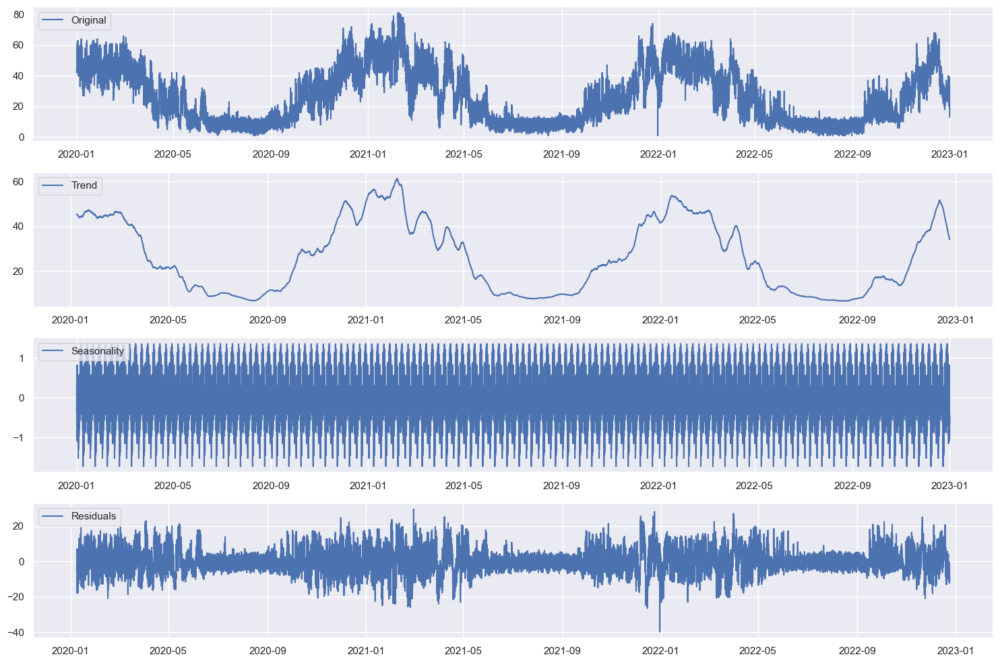

ADF Statistic: -3.719095614425886
p-value: 0.003852435284654286
Meter ID 4902: Optimal number of clusters: 3


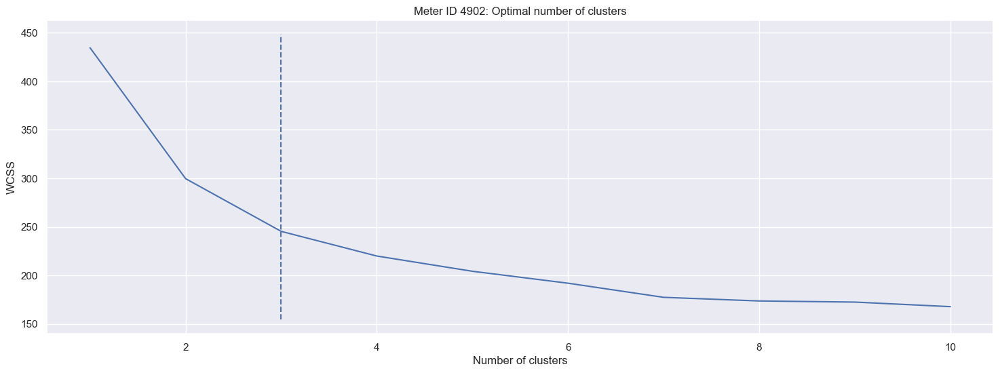

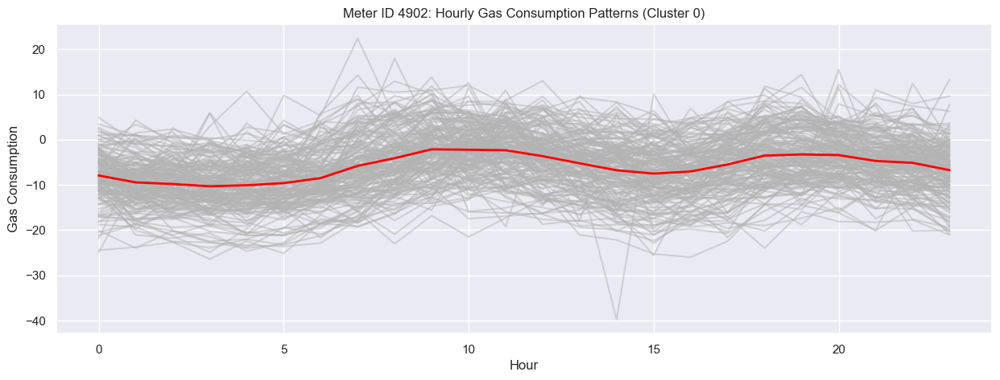

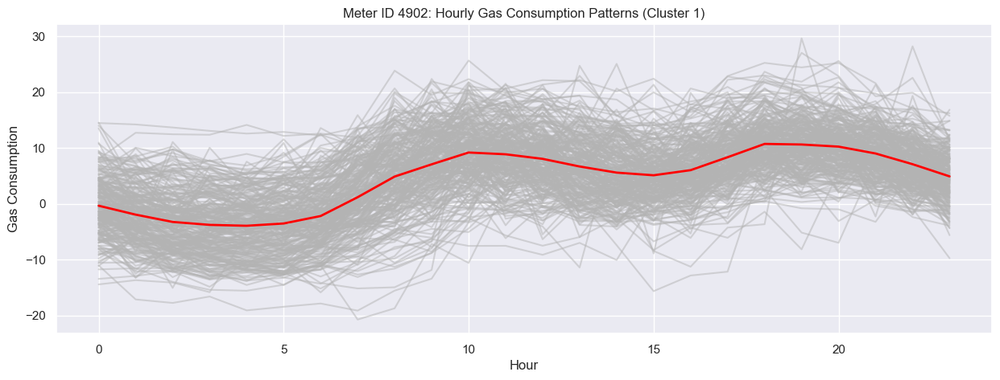

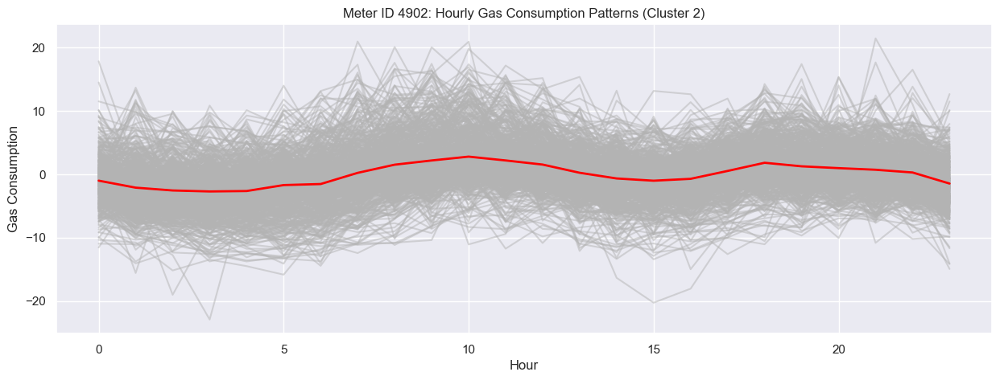

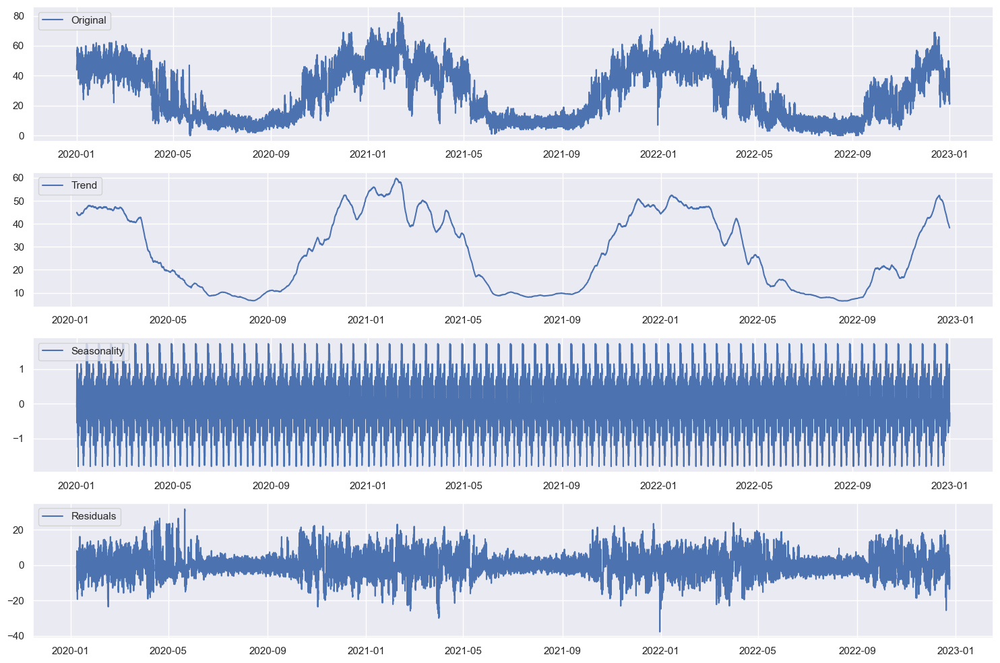

ADF Statistic: -3.464010908608611
p-value: 0.008960930296665755
Meter ID 4903: Optimal number of clusters: 4


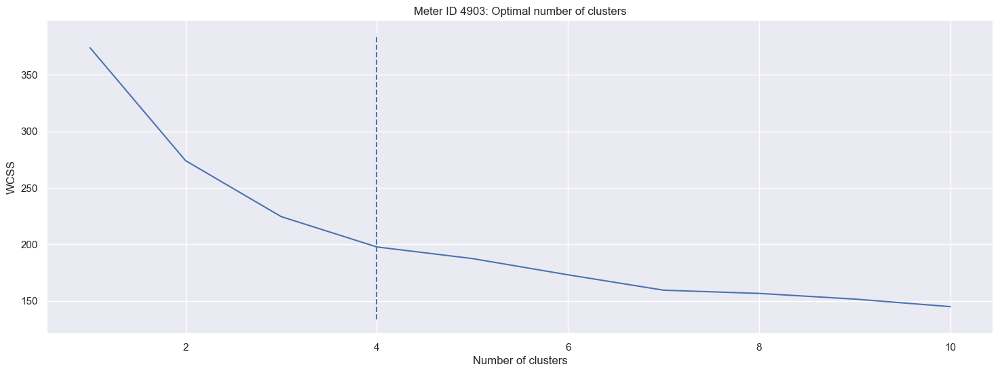

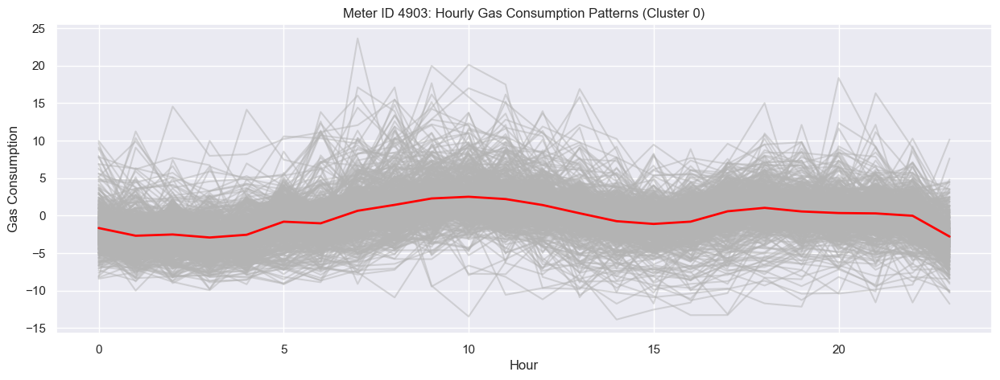

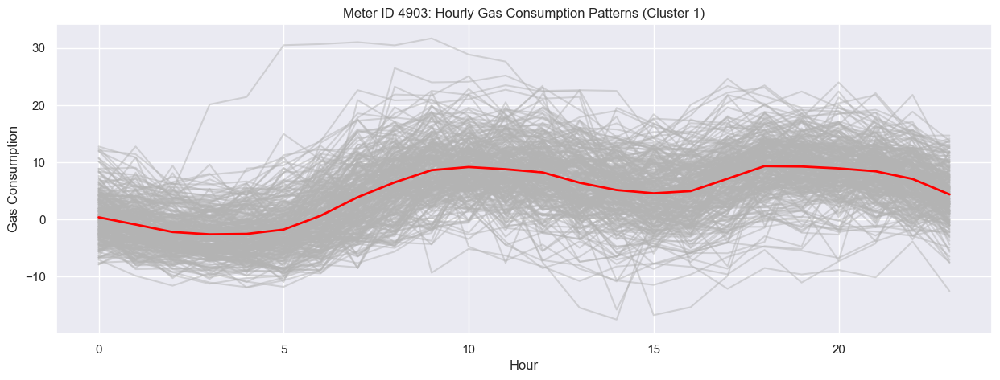

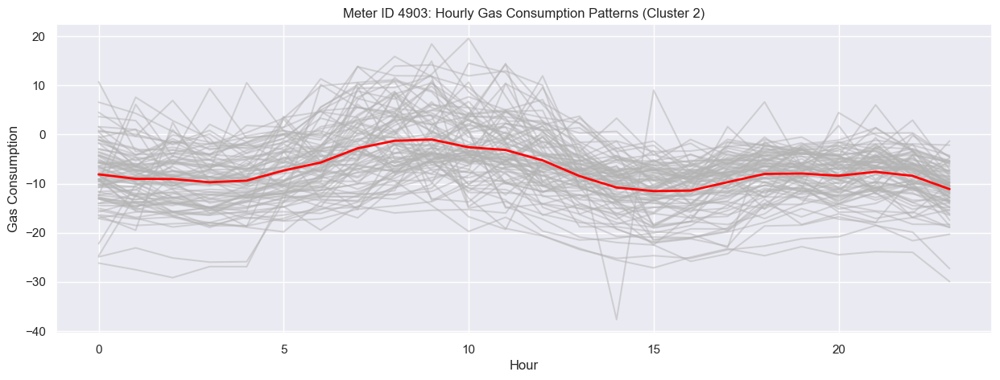

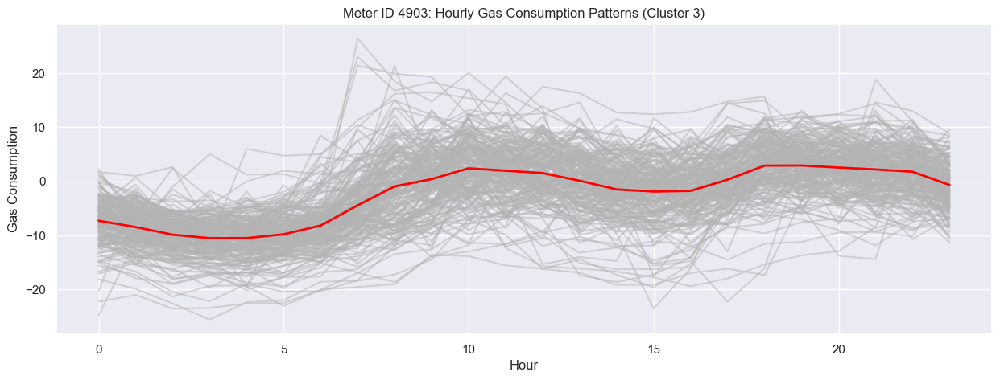

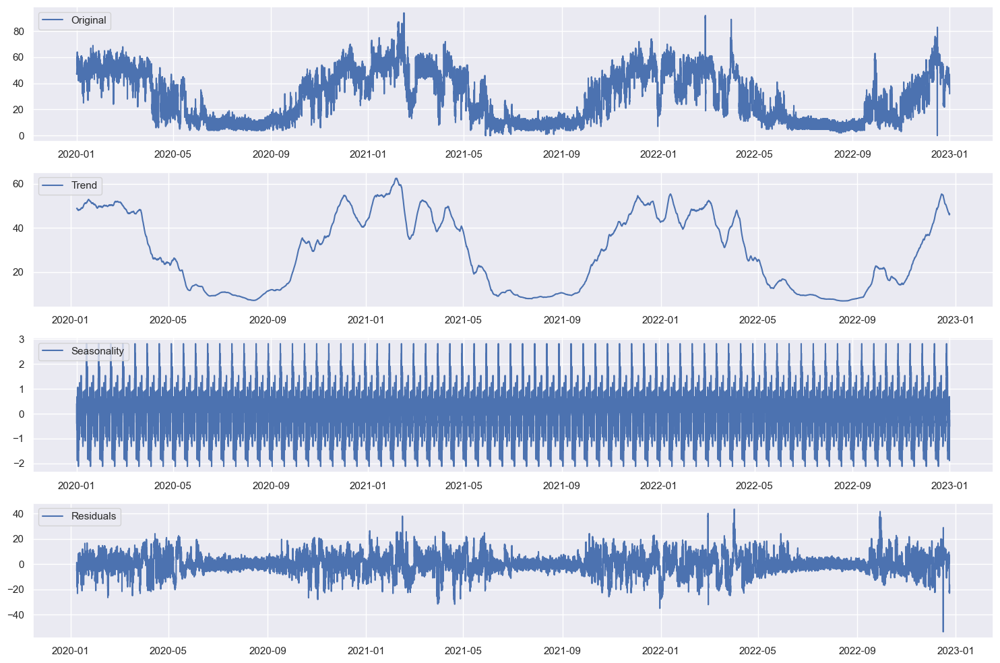

ADF Statistic: -4.529115026610717
p-value: 0.00017414391084240316
Meter ID 4904: Optimal number of clusters: 3


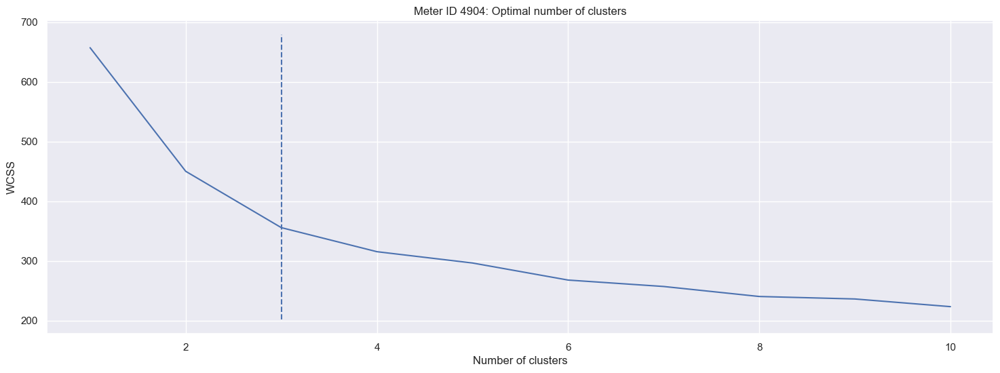

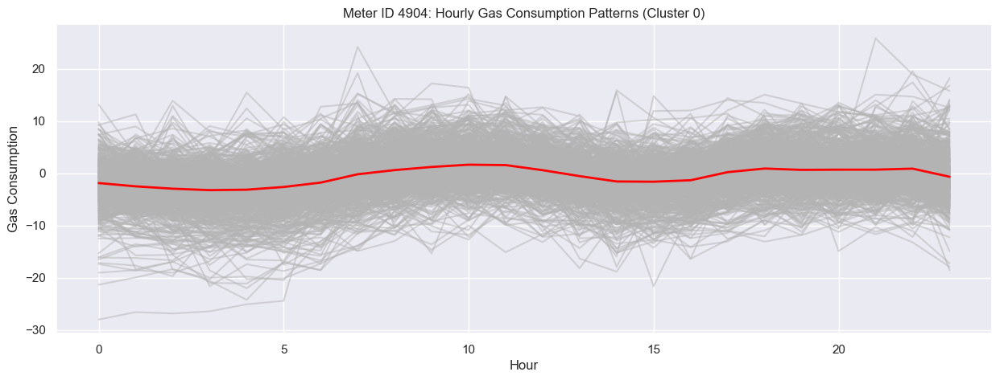

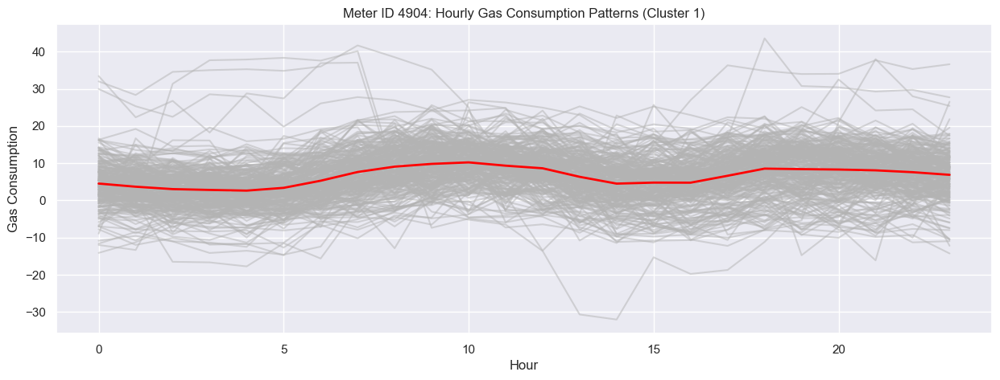

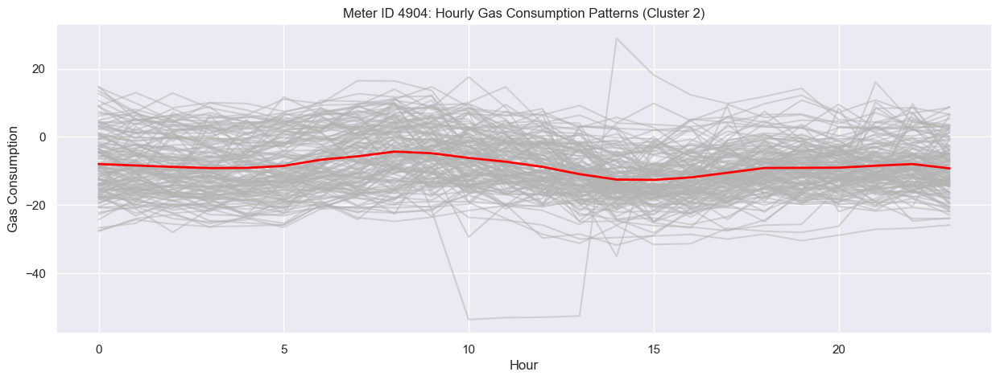

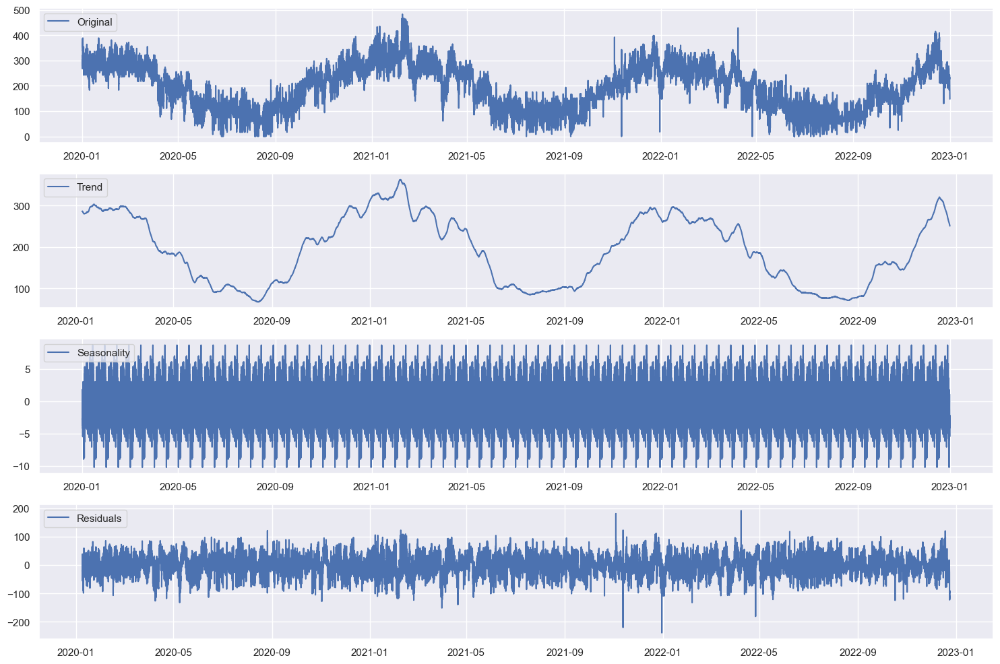

ADF Statistic: -3.4433731913962213
p-value: 0.009566208280819614
Meter ID 4905: Optimal number of clusters: 4


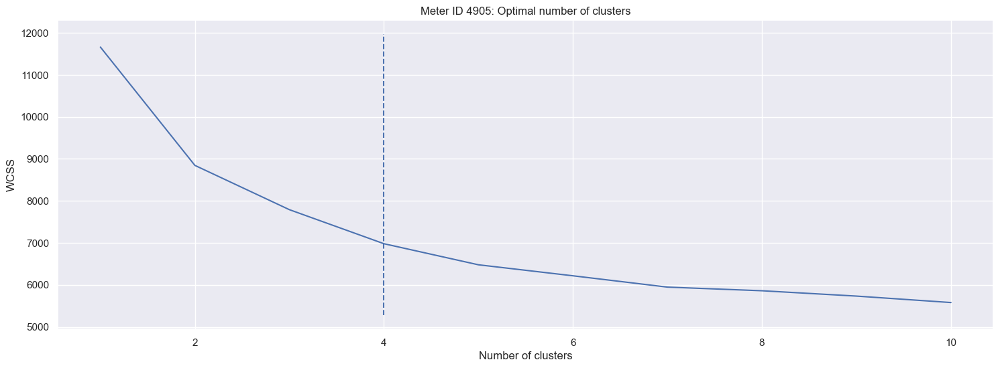

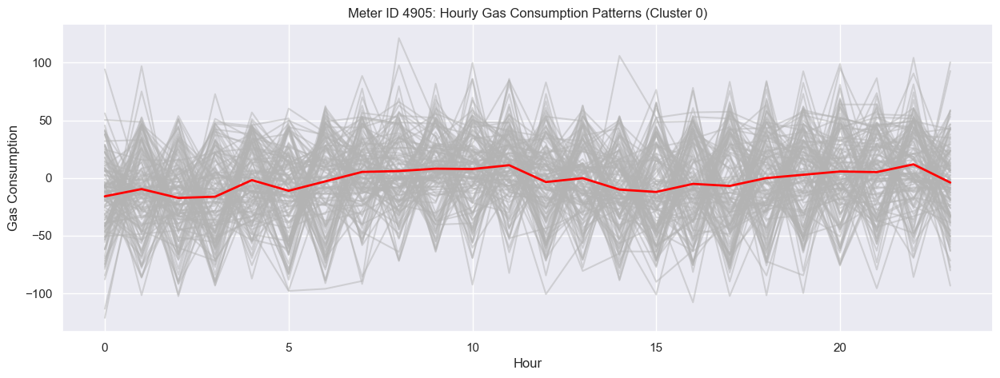

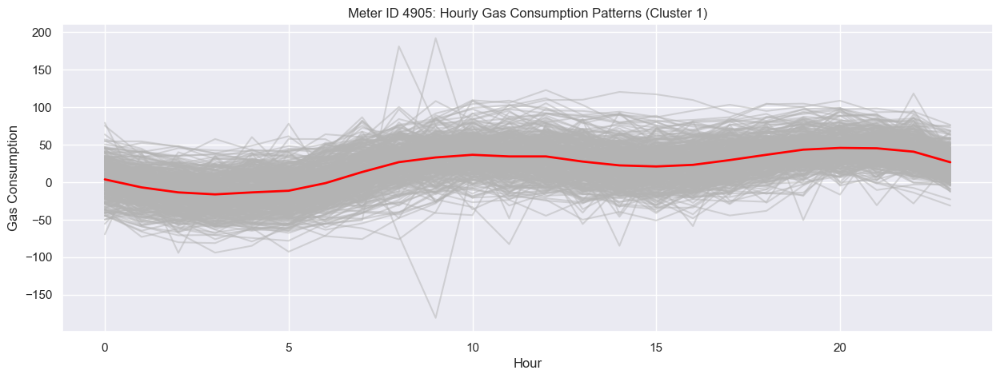

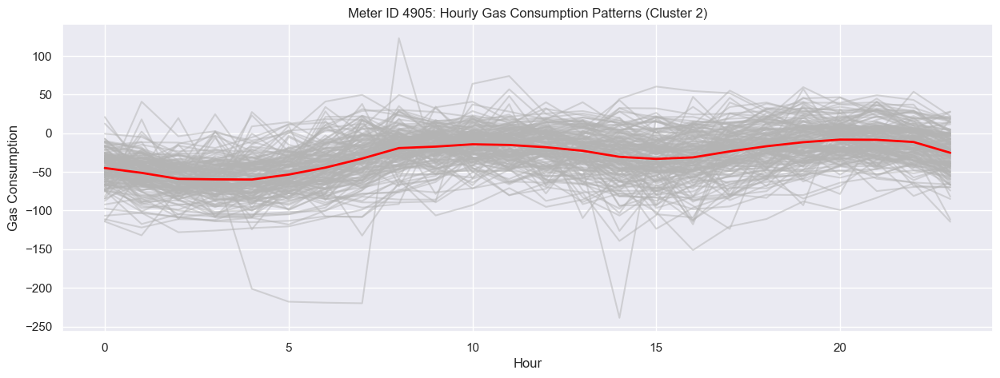

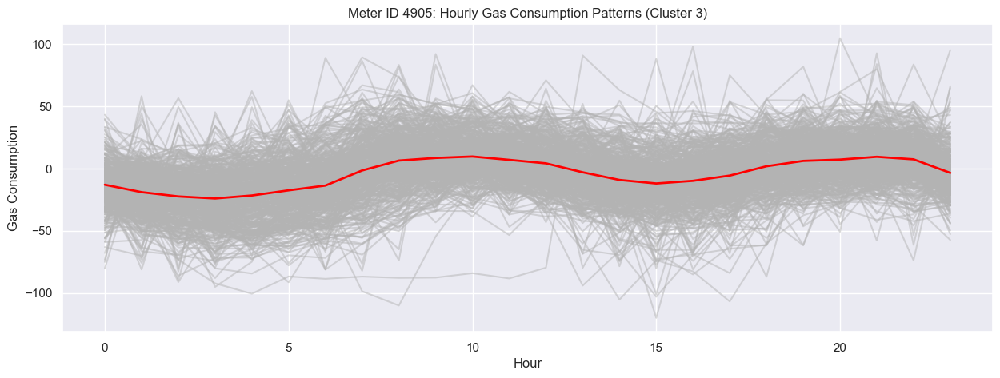

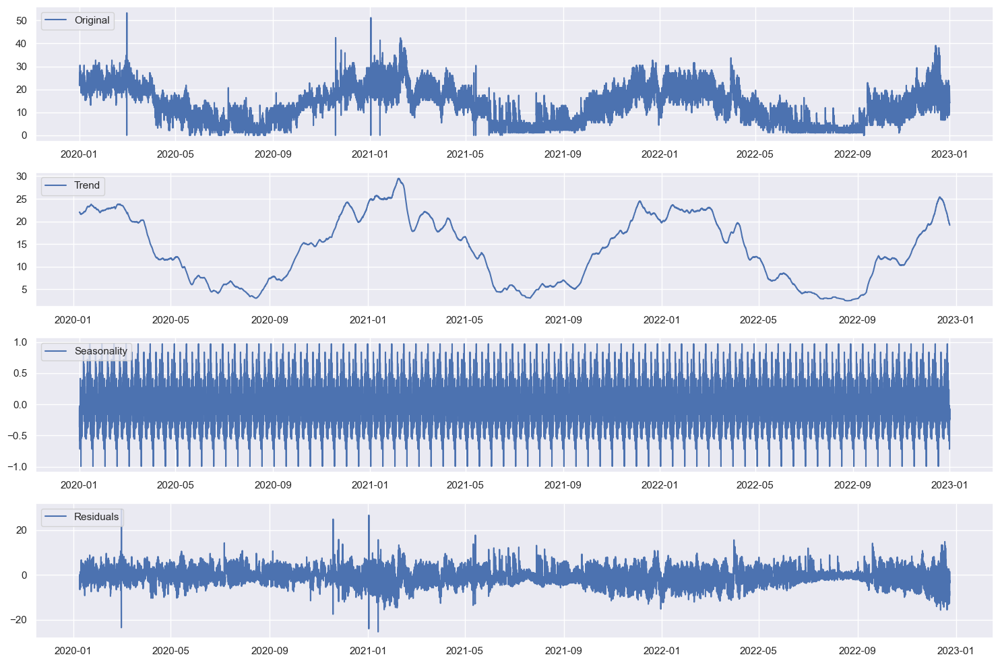

ADF Statistic: -3.6442422184180354
p-value: 0.004969413446105173
Meter ID 40752: Optimal number of clusters: 5


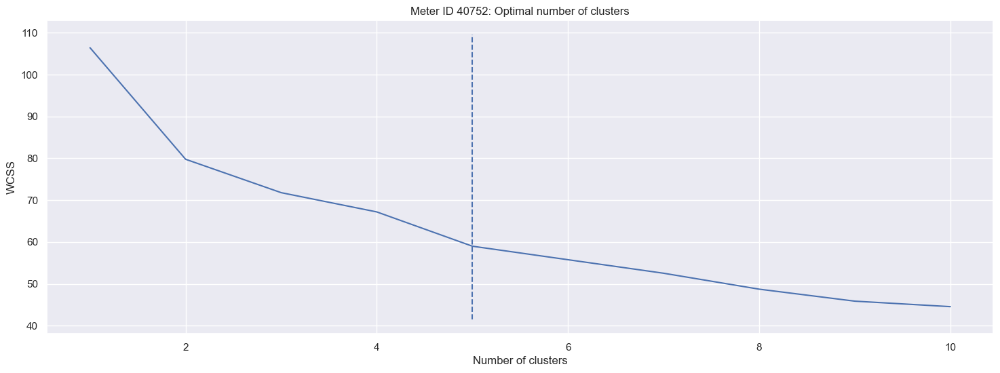

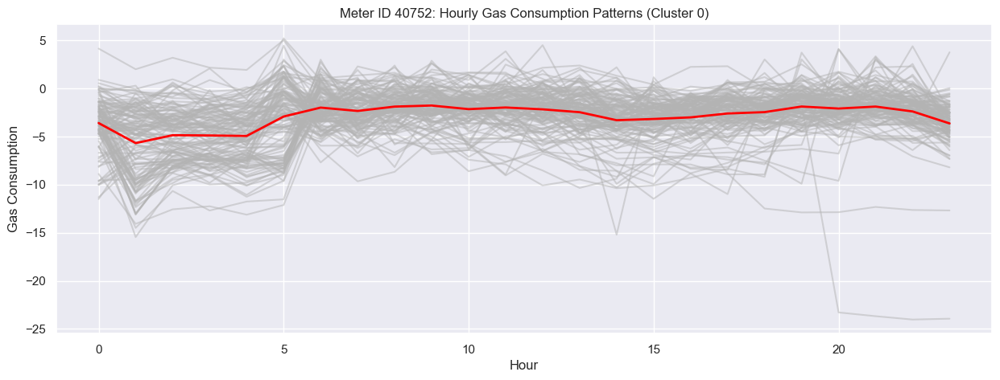

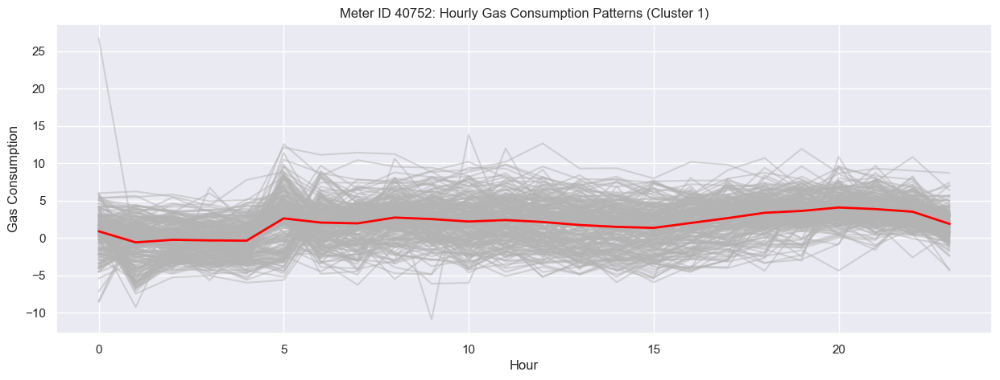

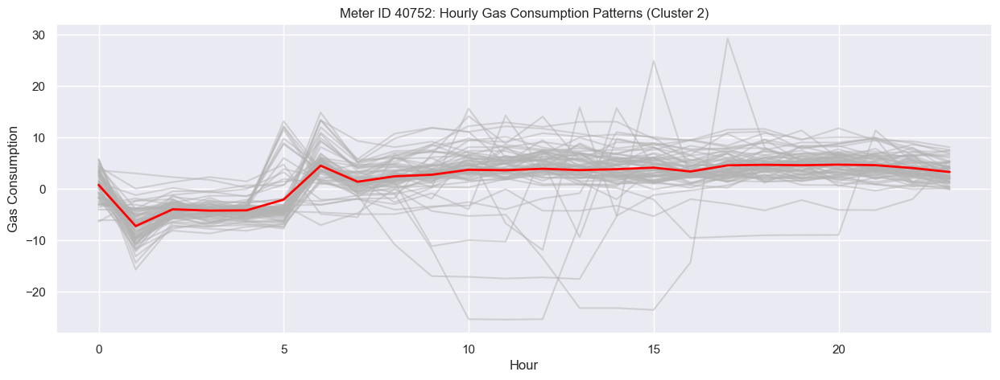

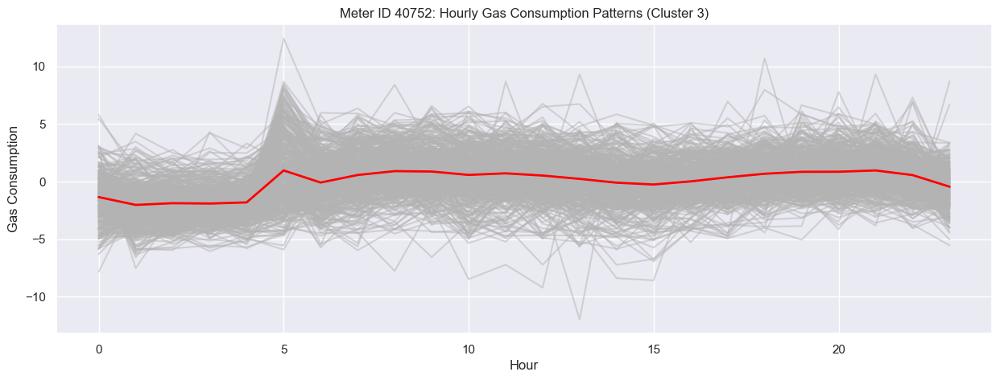

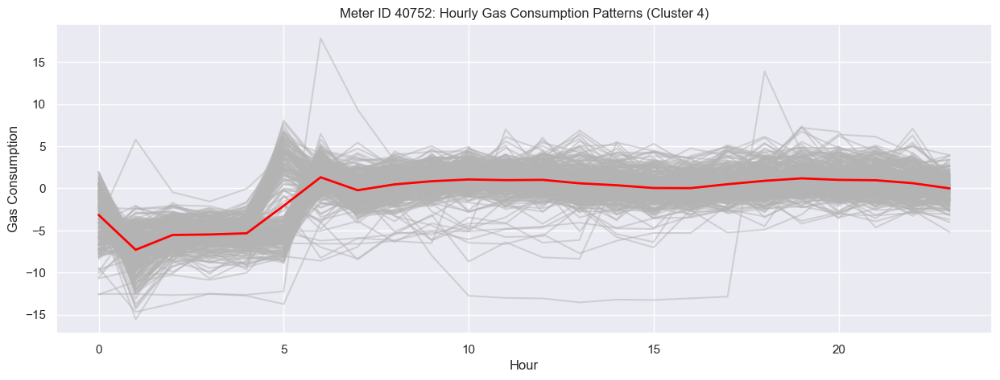

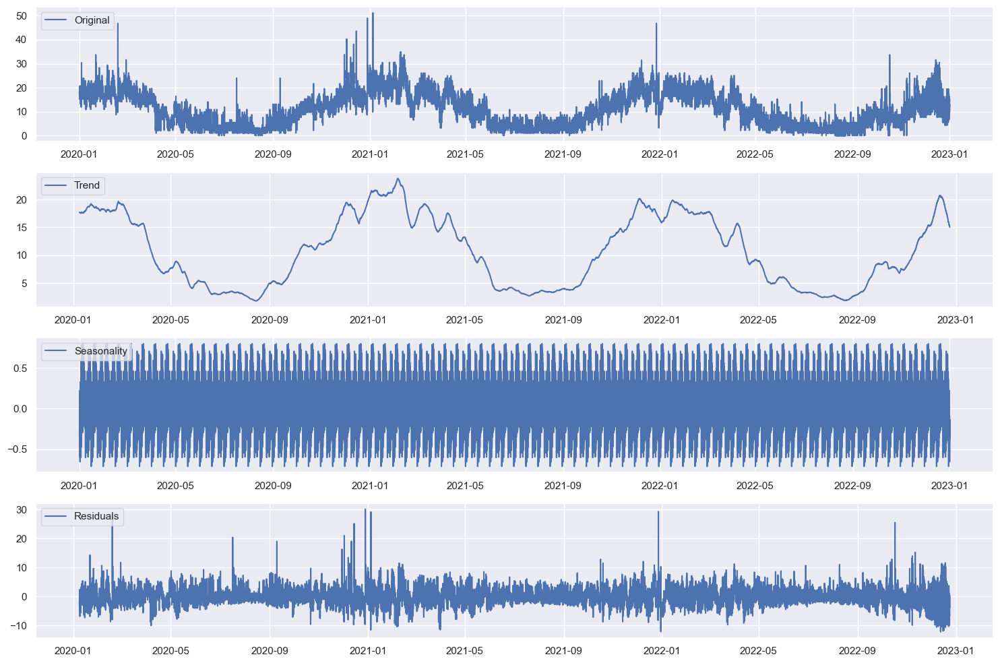

ADF Statistic: -3.4937024853572884
p-value: 0.008150308217557233
Meter ID 40773: Optimal number of clusters: 5


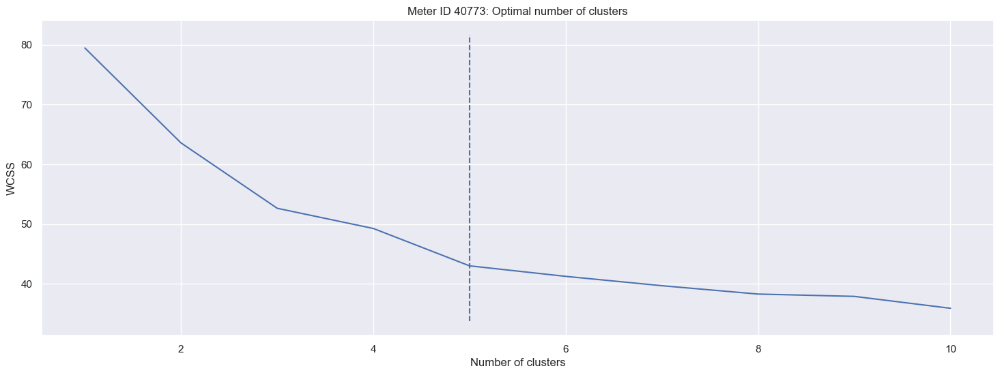

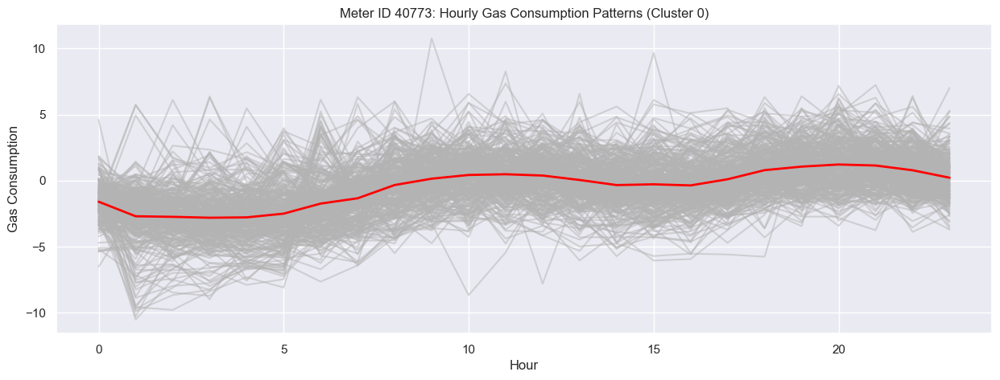

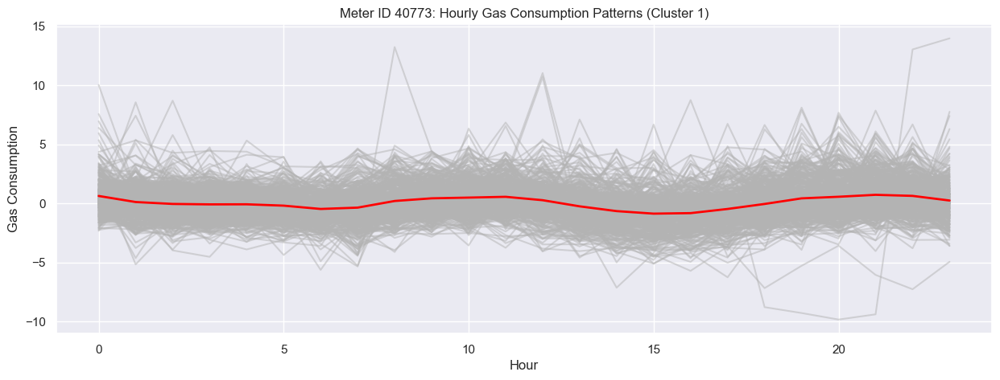

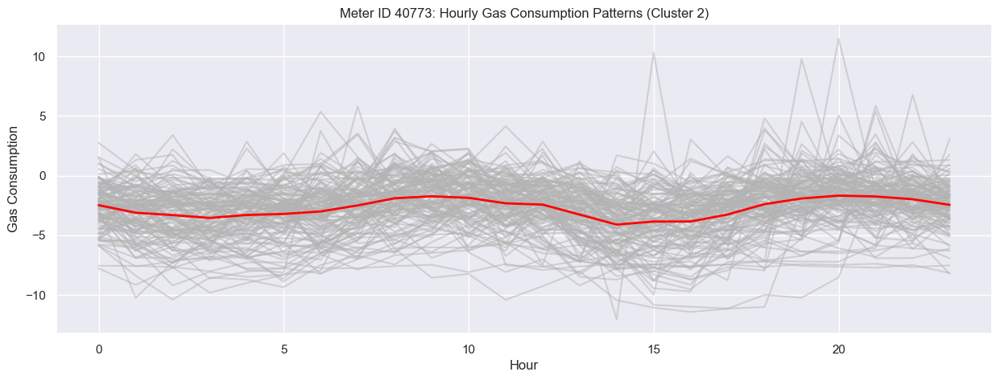

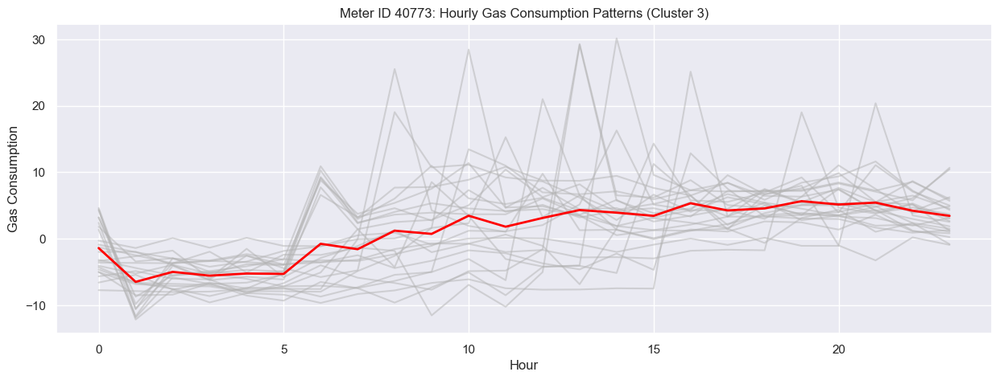

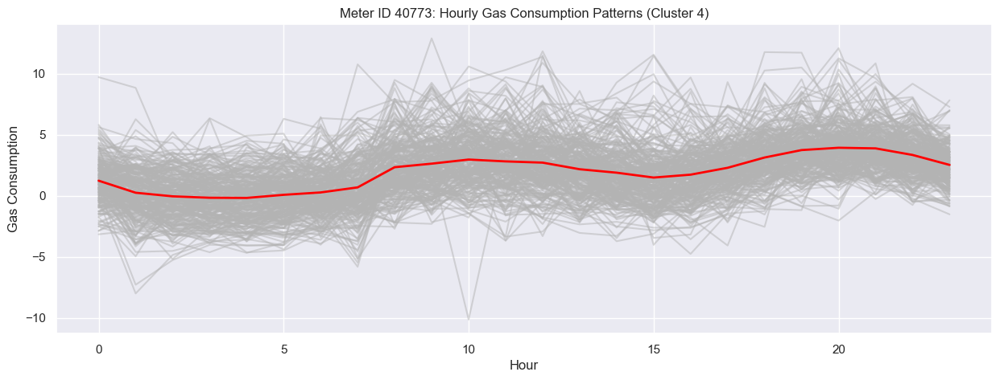

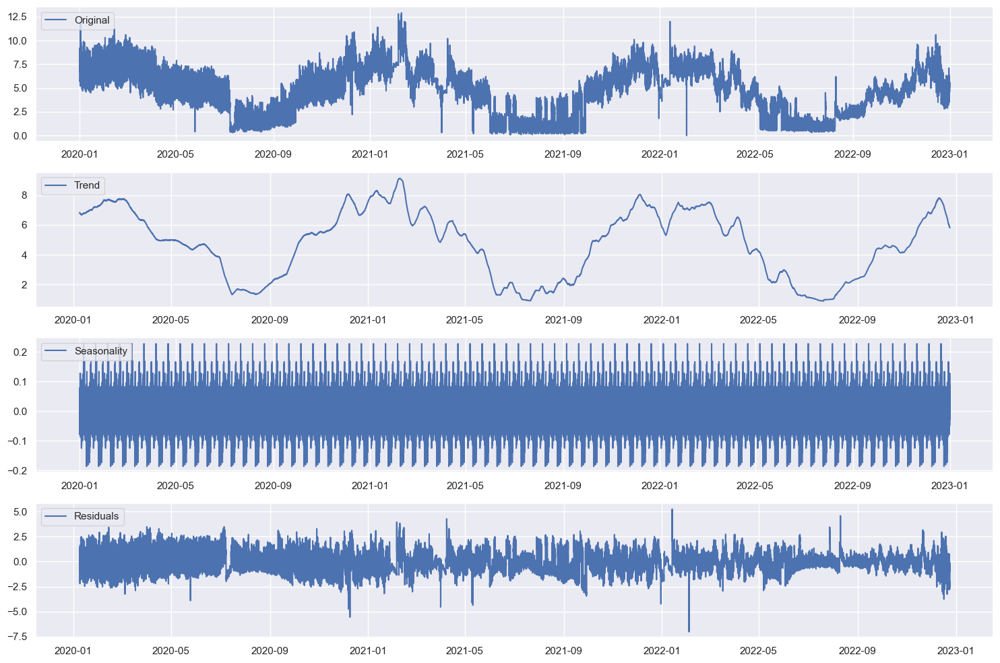

ADF Statistic: -3.322507818175425
p-value: 0.013901867225204489
Meter ID 40812: Optimal number of clusters: 4


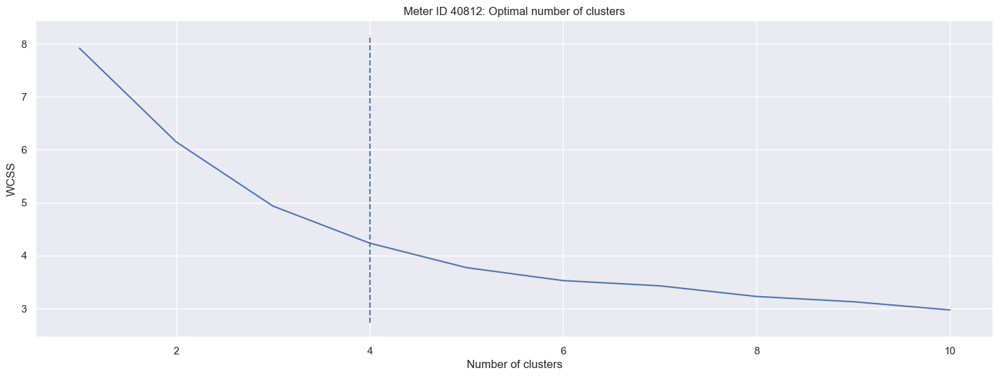

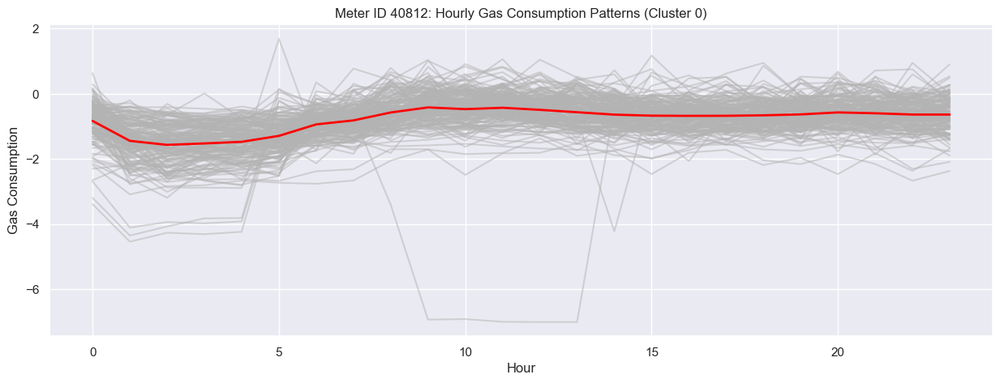

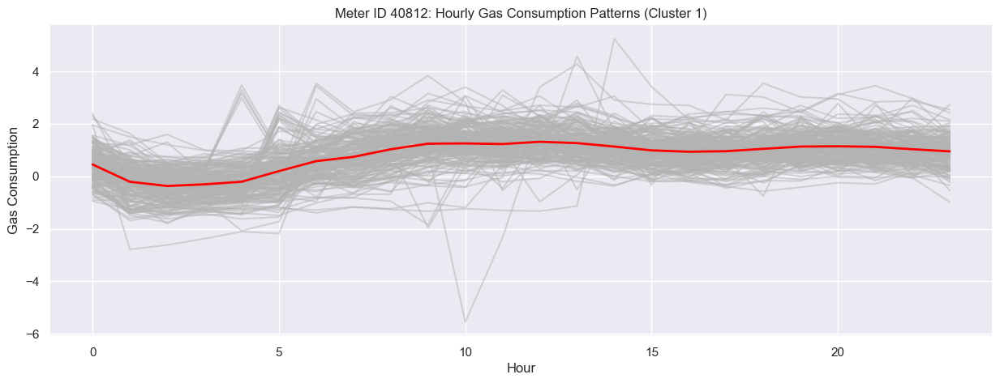

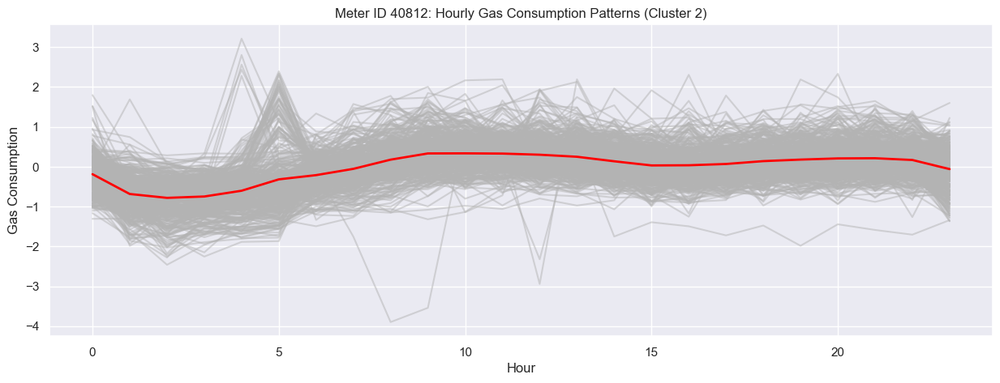

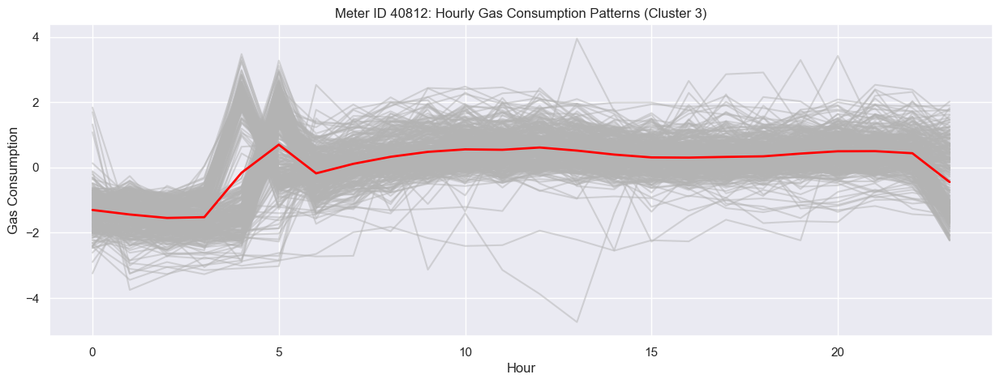

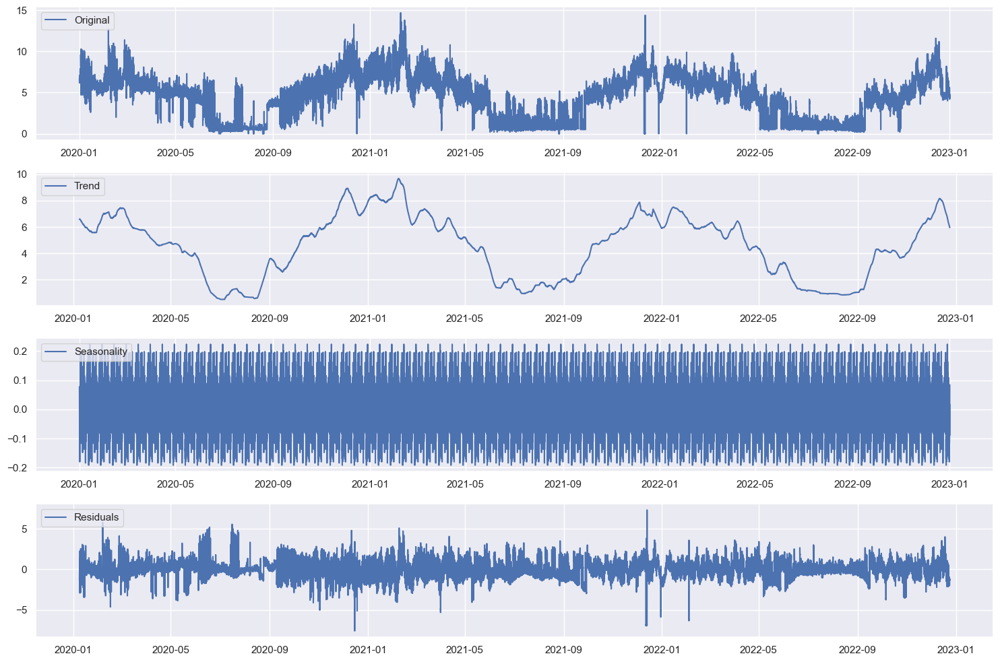

ADF Statistic: -3.704490725467
p-value: 0.004050429643931584
Meter ID 41574: Optimal number of clusters: 4


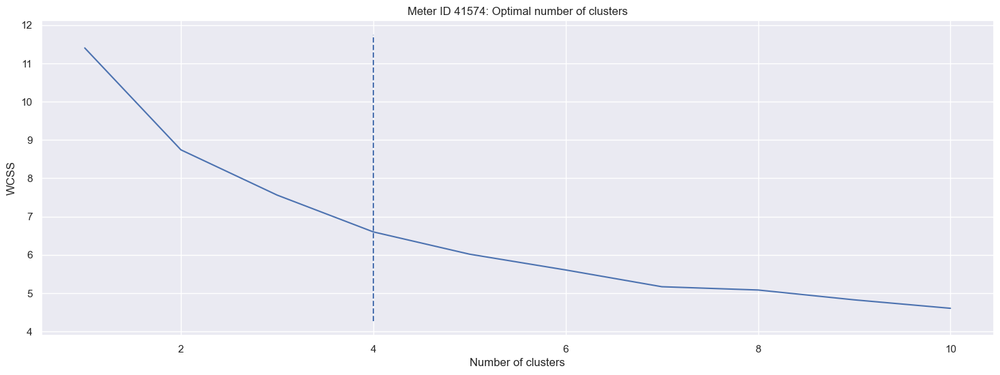

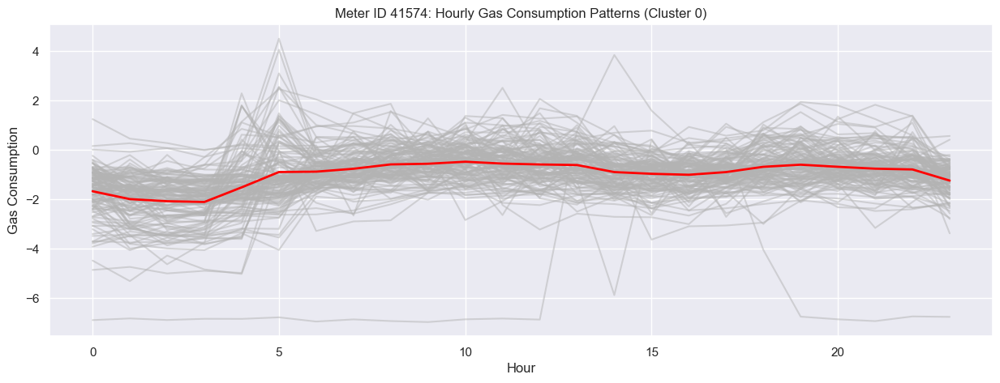

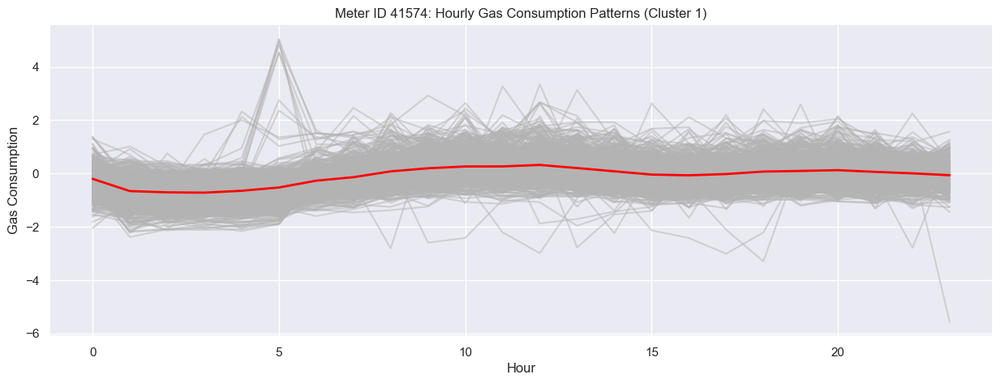

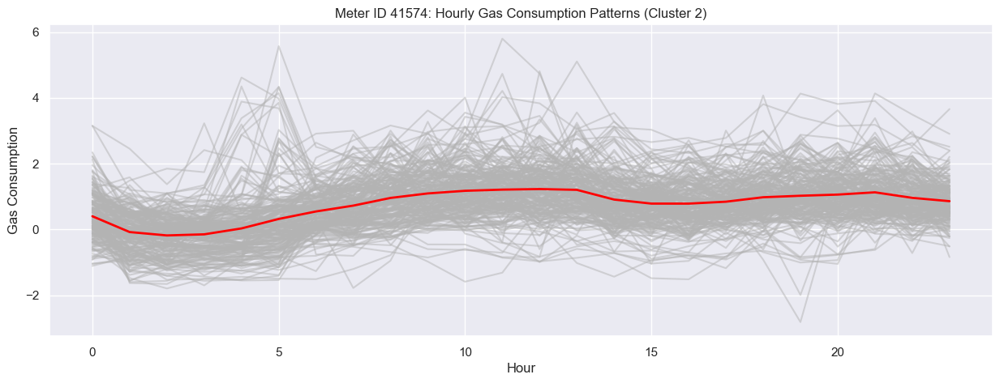

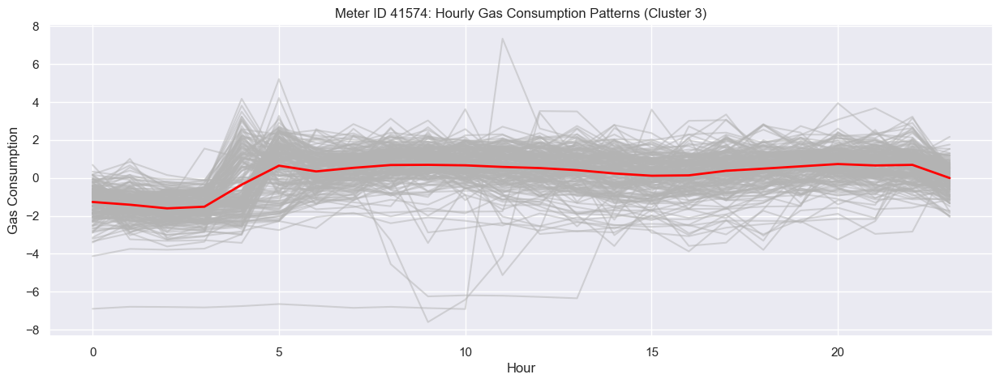

In [329]:
clustered_resid_data = {}

for meter_id in ids_and_descriptions:
    resid_data = time_series_analysis(gas_data, meter_id)
    clustered_data = analyze_and_plot_meter_data_resid(resid_data, meter_id)
    clustered_resid_data[meter_id] = clustered_data


## Plot original data based on revmove seasonality 

In [325]:
def plot_original_hourly_data(gas_data, meter_id, clustered_resid_data):
    # Filter data by meter_id
    gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')

    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_hourly_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_hourly_grouped.index.names = ['date', 'hour']
    data_hourly_unstacked = data_hourly_grouped.unstack(level=-1)
    data_hourly_unstacked = data_hourly_unstacked.dropna()
    data_hourly_unstacked.columns = [f'hour_{i}' for i in range(24)]

    # Get the clustered data from the existing results
    clustered_data = clustered_resid_data[meter_id]
    optimal_k = clustered_data['optimal_k']
    cluster_groups = clustered_data['cluster_groups']

    # Group the original data by cluster assignment
    original_cluster_groups = {}
    for cluster, cluster_group in cluster_groups.items():
        cluster_dates = cluster_group.index
        original_cluster_groups[cluster] = data_hourly_unstacked.loc[cluster_dates]

    # Find the global maximum and minimum gas consumption values across all clusters
    global_max = max(cluster_group.max().max() for cluster_group in original_cluster_groups.values())
    global_min = min(cluster_group.min().min() for cluster_group in original_cluster_groups.values())

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours

    for i, cluster_group in original_cluster_groups.items():
        fig, ax = plt.subplots(figsize=(15, 5))
        for _, row in cluster_group.iterrows():
            ax.plot(x_axis_values, row.values, color='0.7', alpha=0.5)

        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Original Hourly Gas Consumption Patterns (Cluster {i})")

        # Set the y-axis limits to the global maximum and minimum values
        ax.set_ylim(global_min, global_max)

        plt.show()

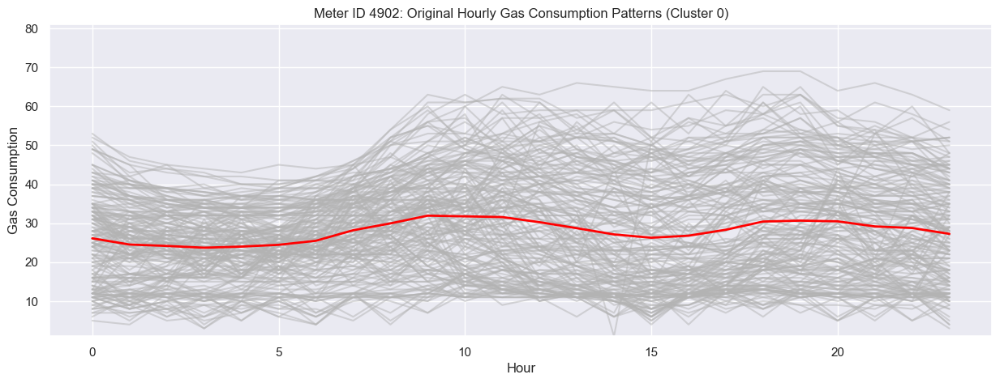

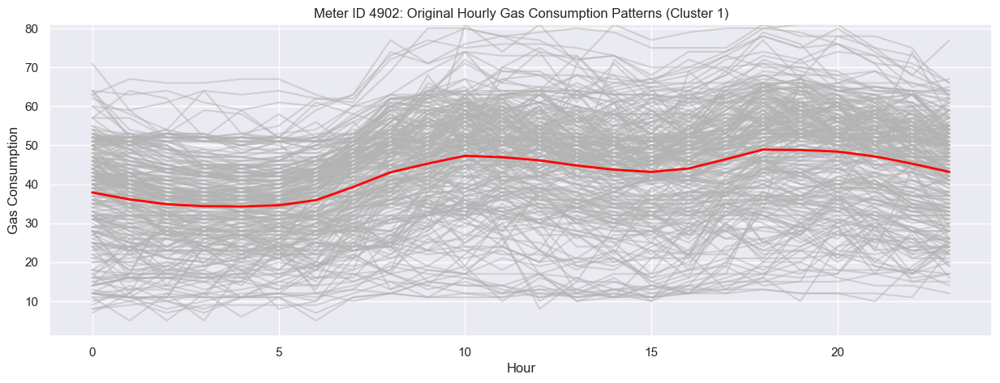

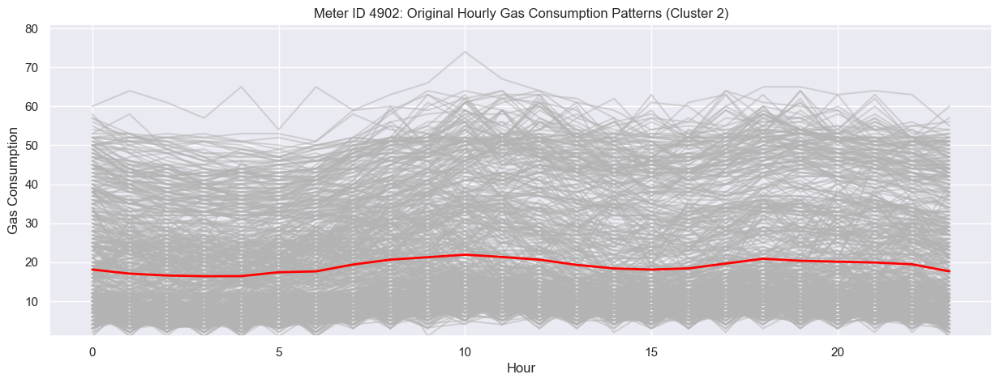

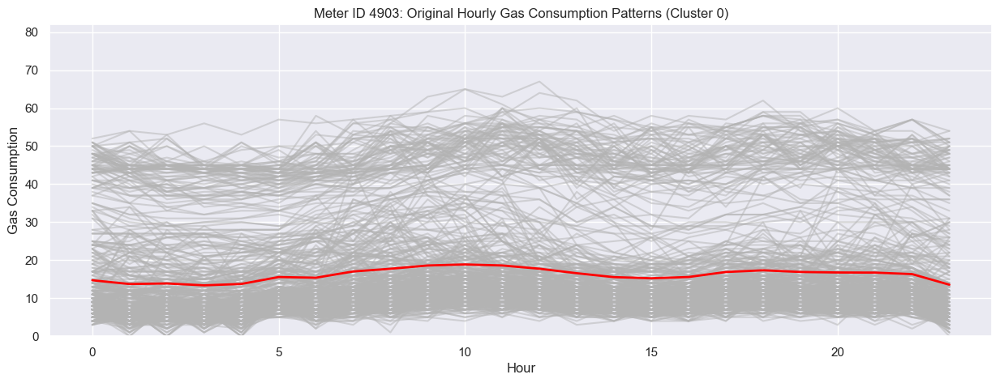

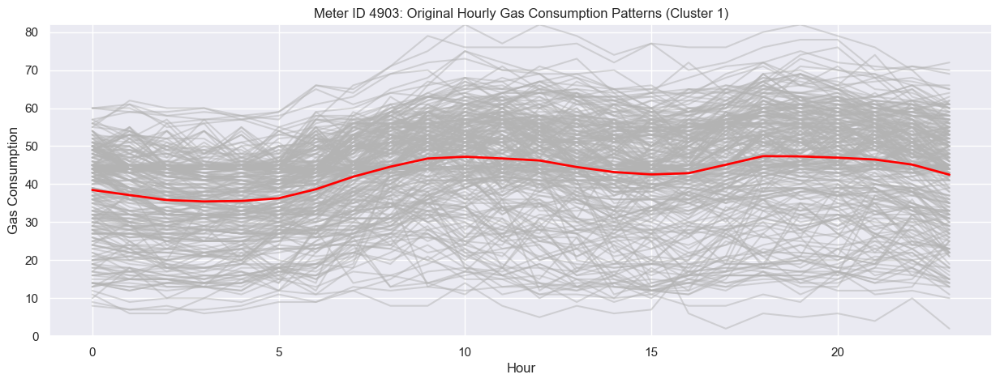

...

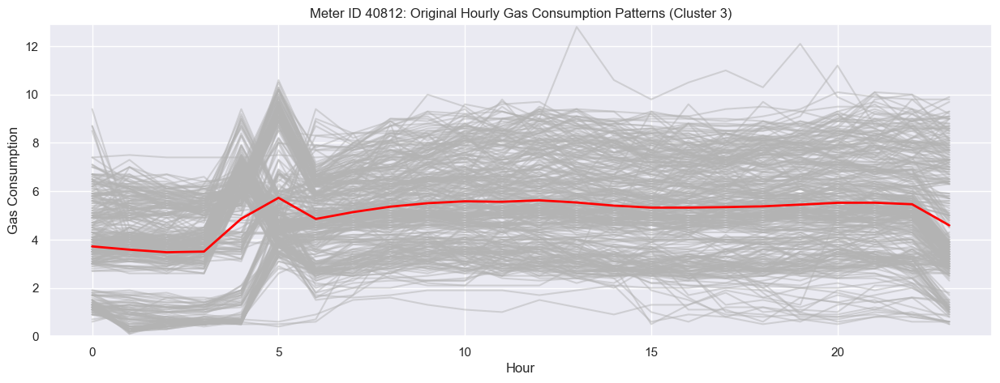

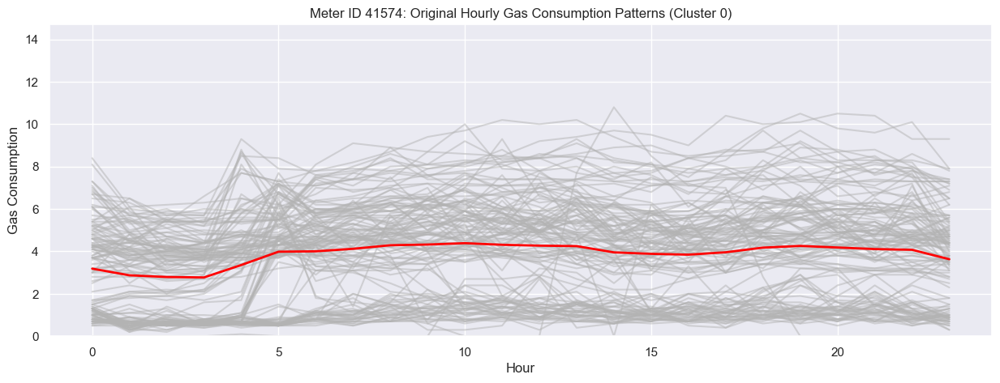

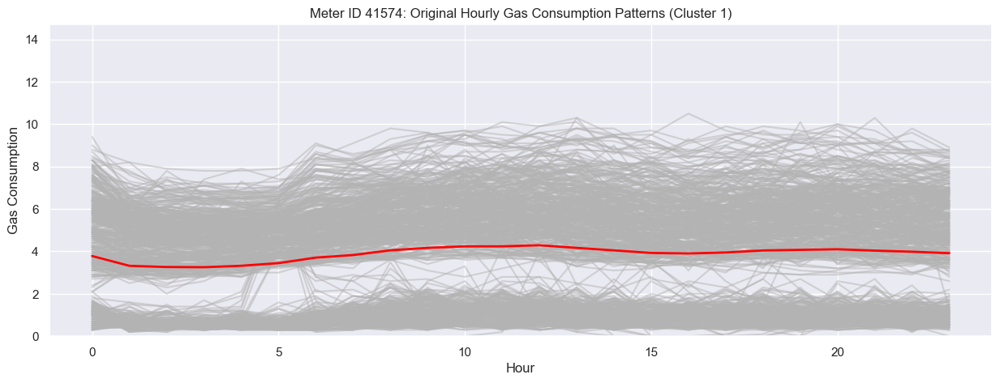

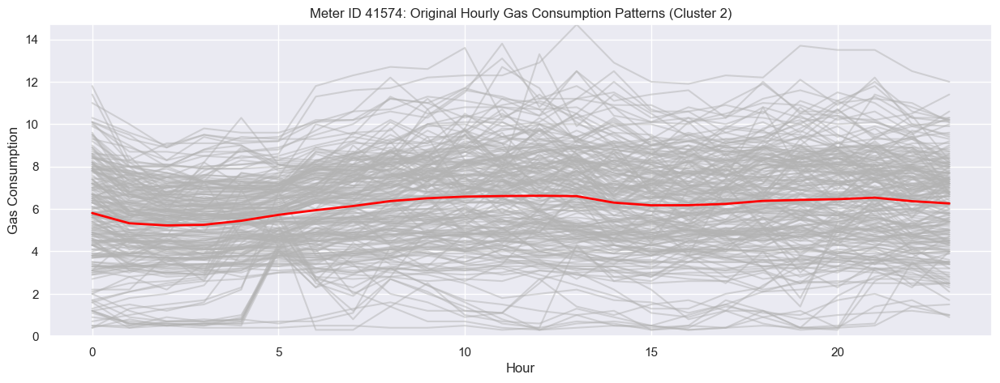

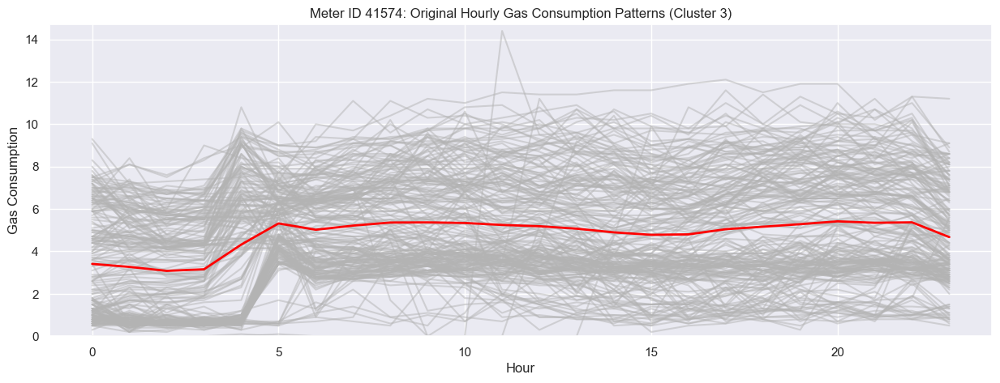

In [330]:
for meter_id in ids_and_descriptions:
    plot_original_hourly_data(gas_data, meter_id, clustered_resid_data)


## exclude weekends

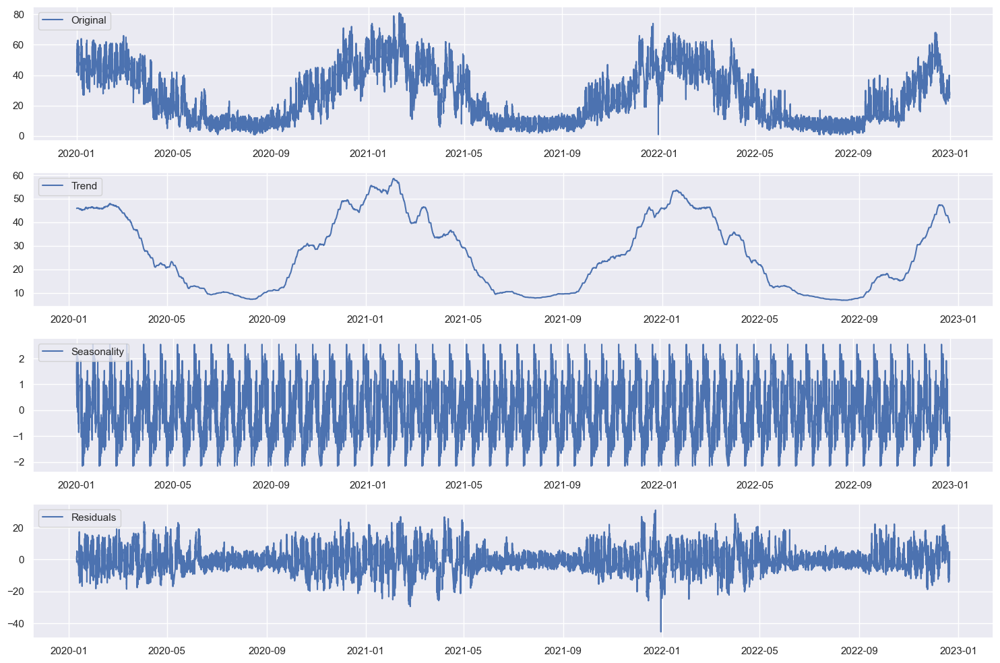

ADF Statistic: -3.346232446244729
p-value: 0.012934196601999801
Meter ID 4902: Optimal number of clusters: 3


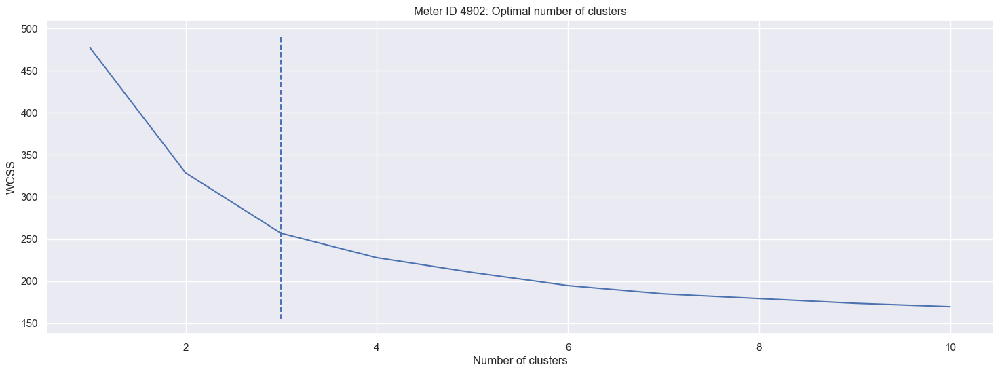

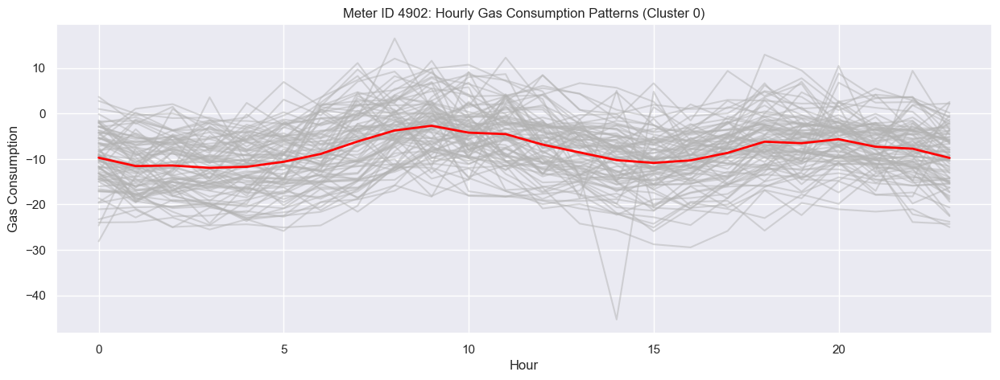

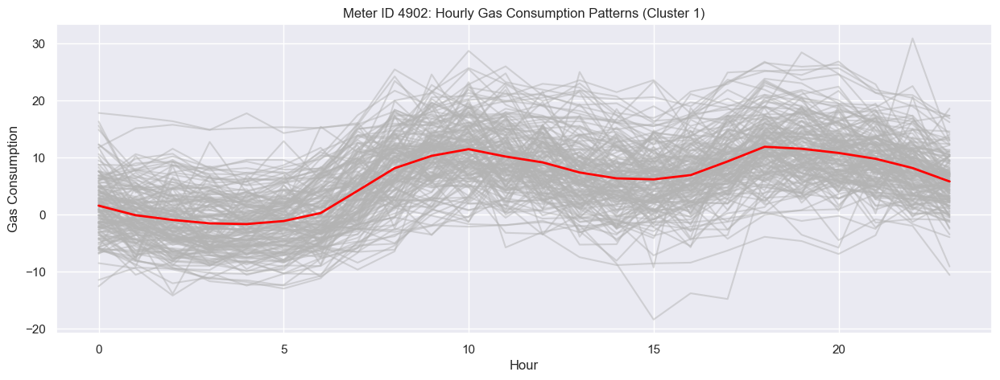

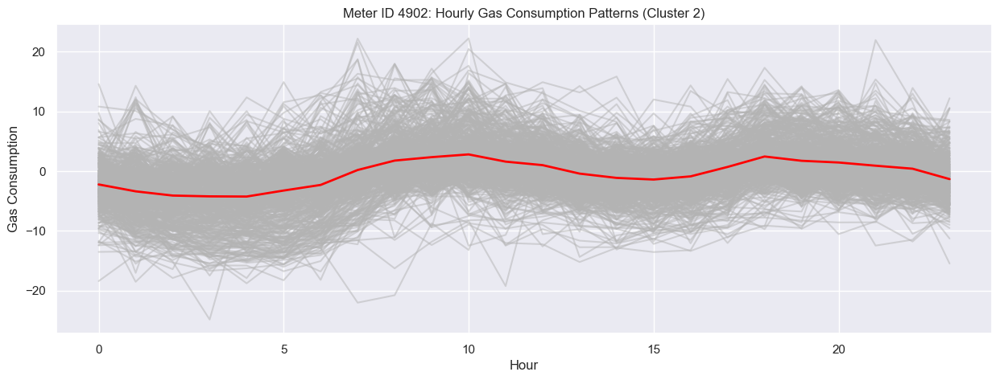

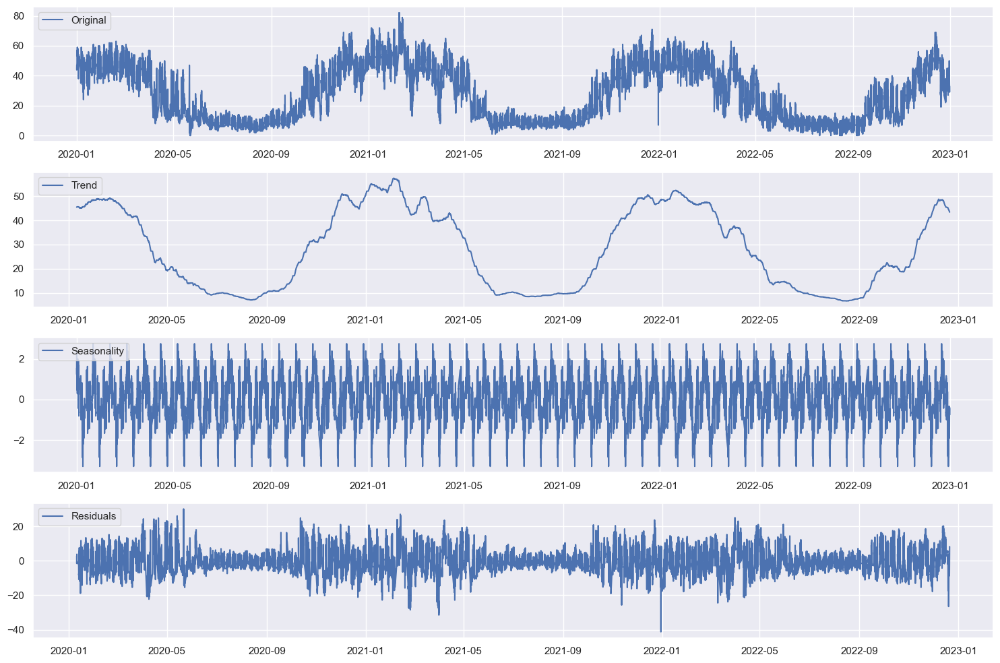

ADF Statistic: -3.072825413072814
p-value: 0.02863069104463854
Meter ID 4903: Optimal number of clusters: 3


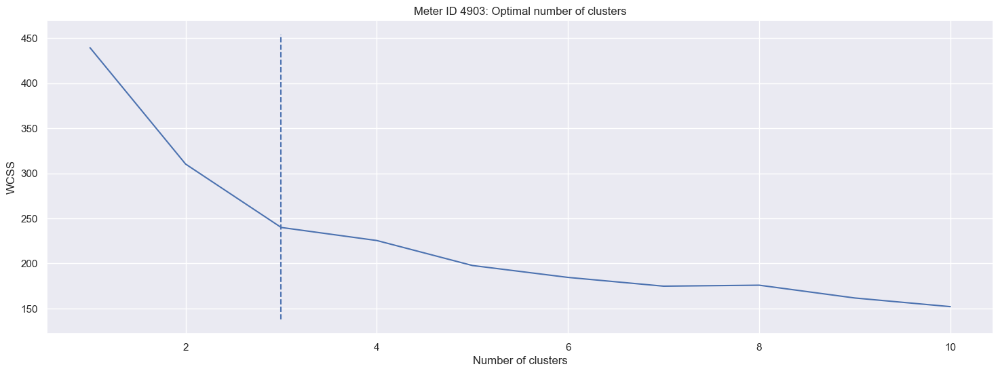

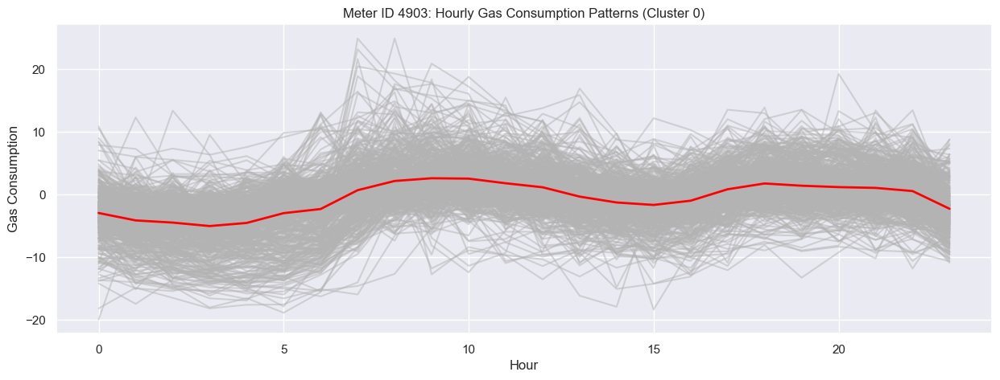

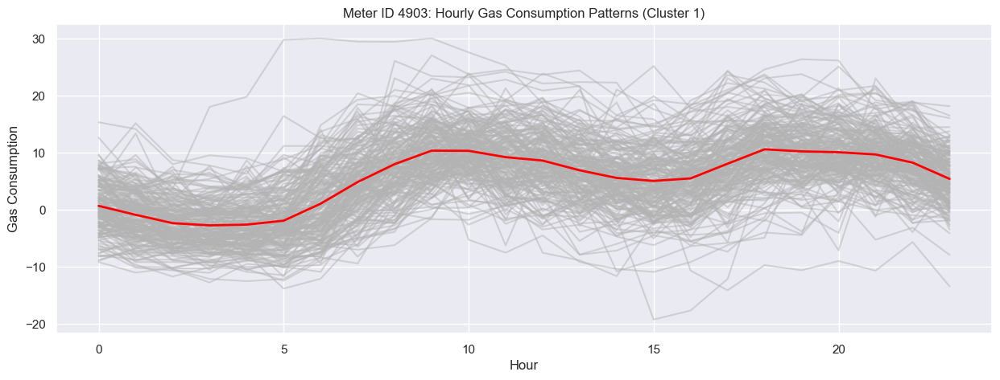

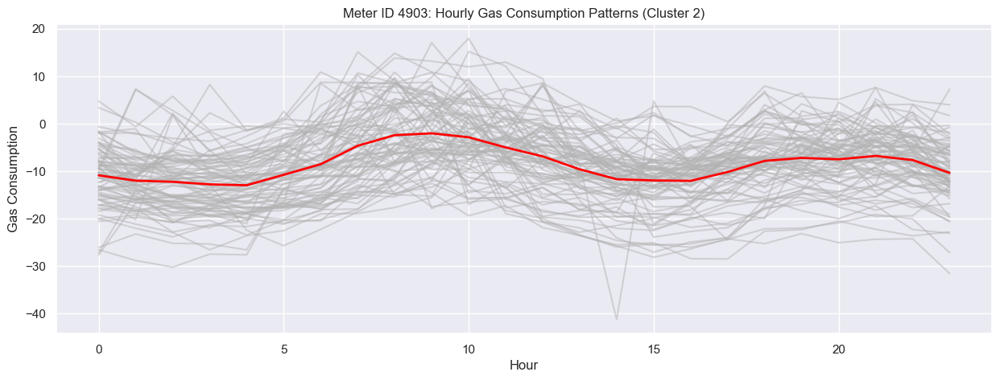

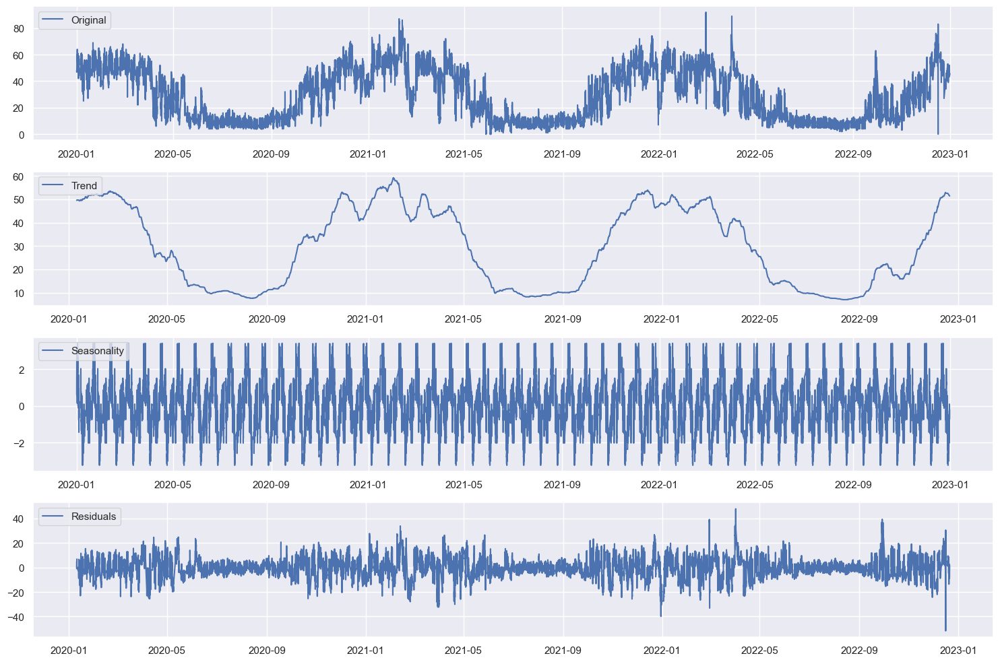

ADF Statistic: -3.913773868600791
p-value: 0.0019357852669823715
Meter ID 4904: Optimal number of clusters: 3


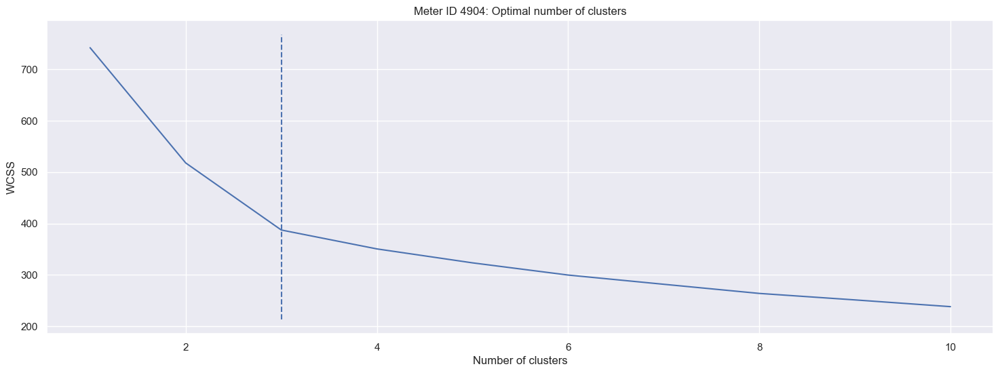

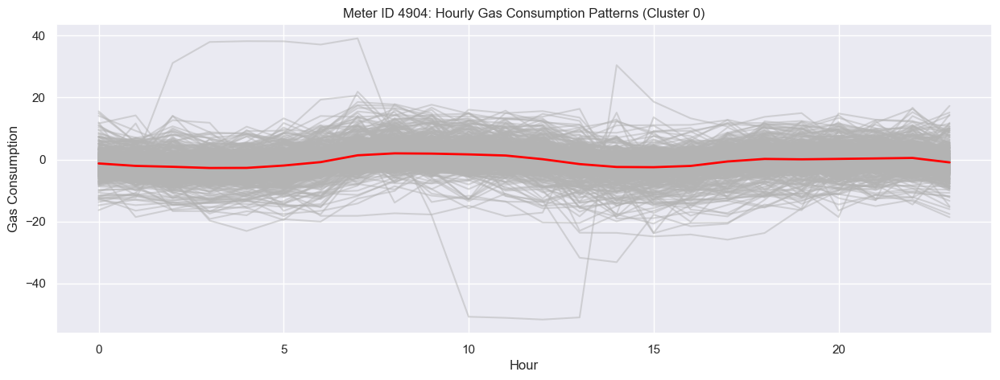

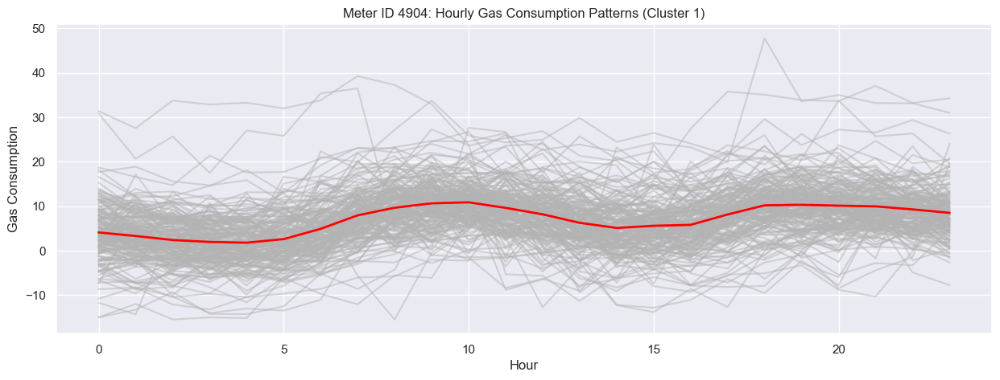

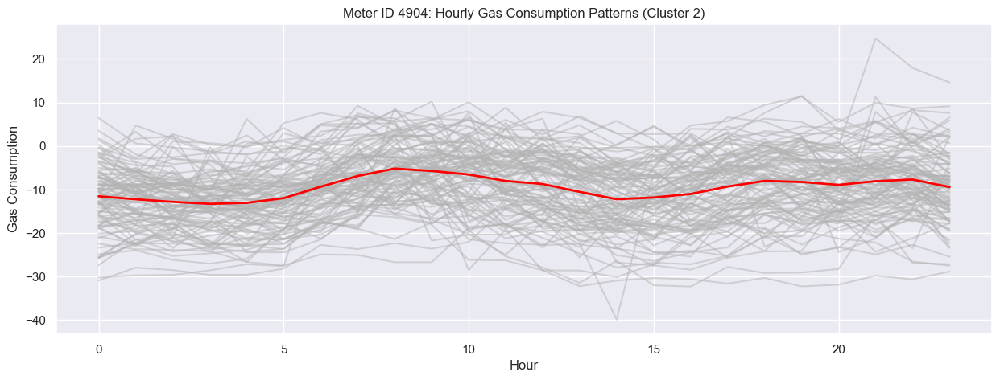

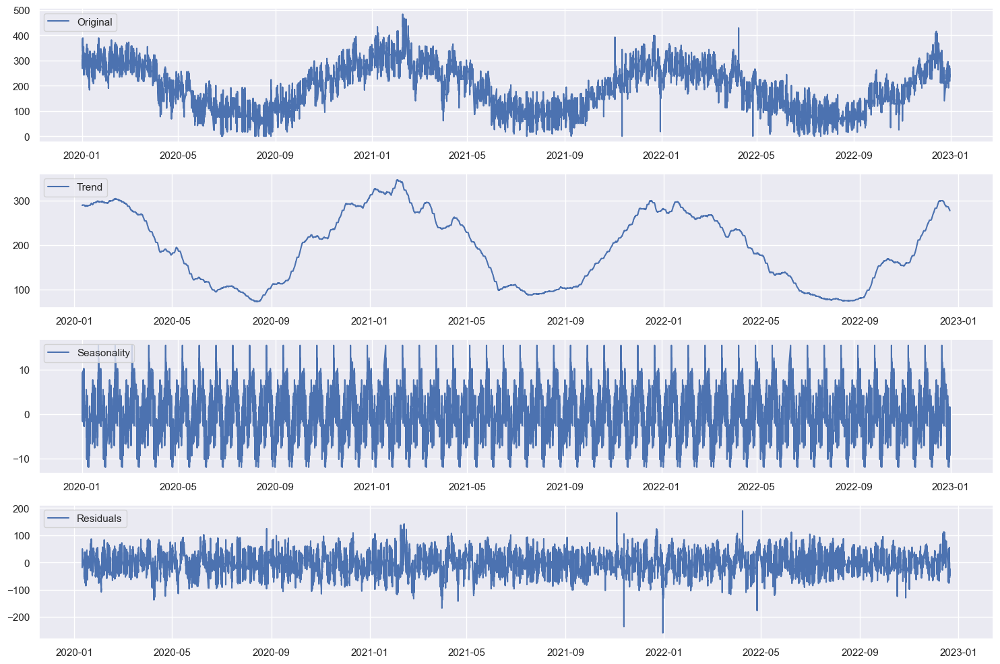

ADF Statistic: -3.3207665715792842
p-value: 0.013975345979924043
Meter ID 4905: Optimal number of clusters: 4


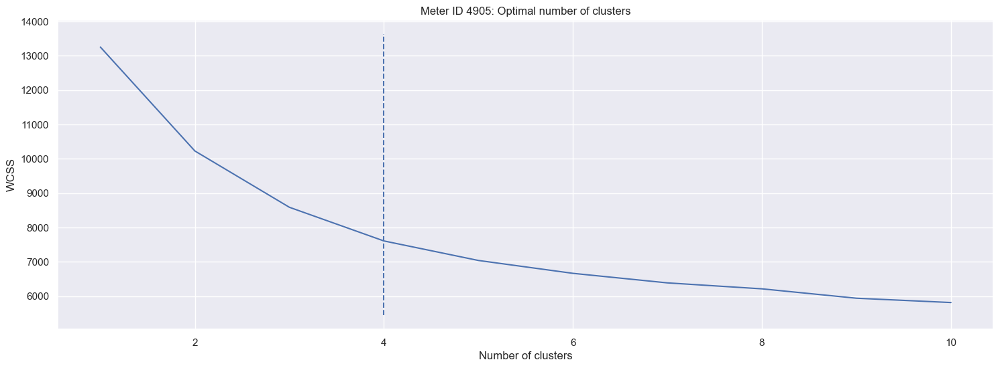

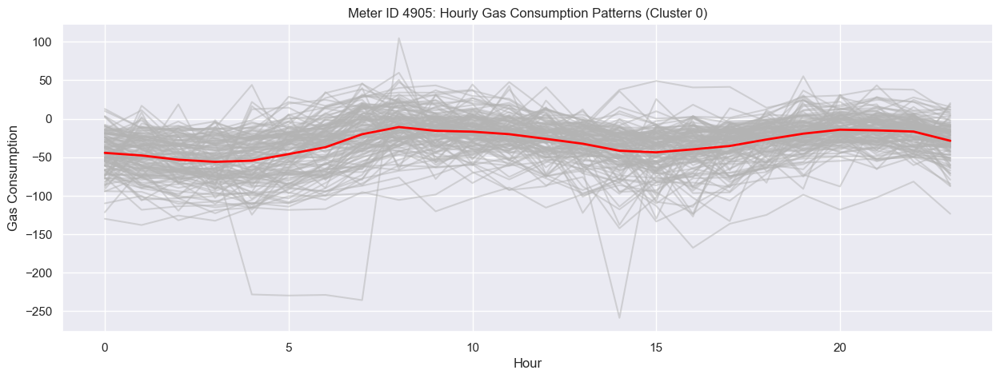

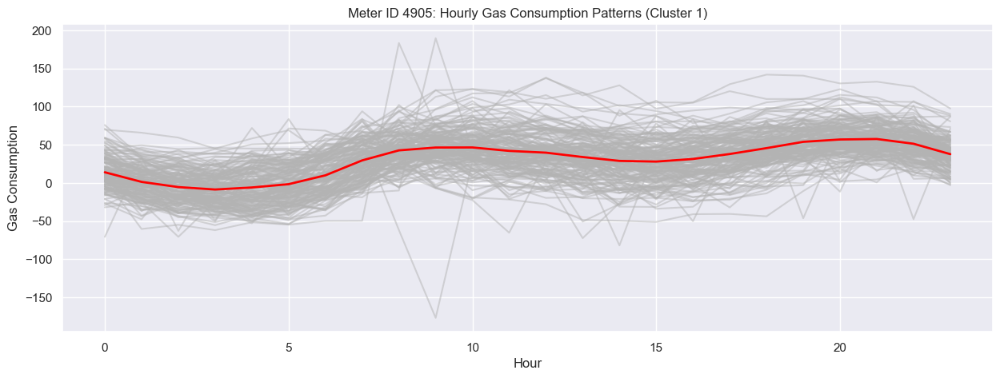

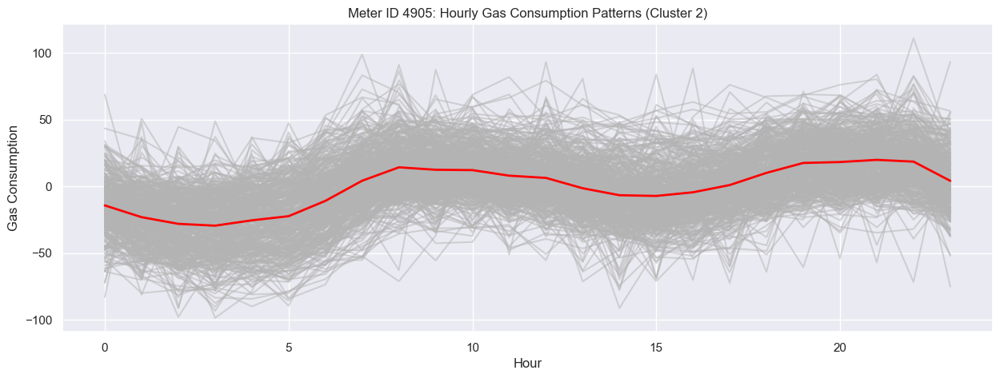

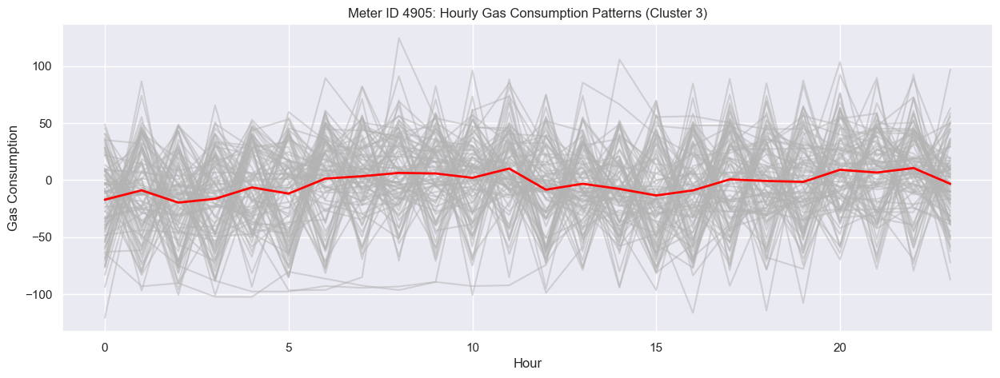

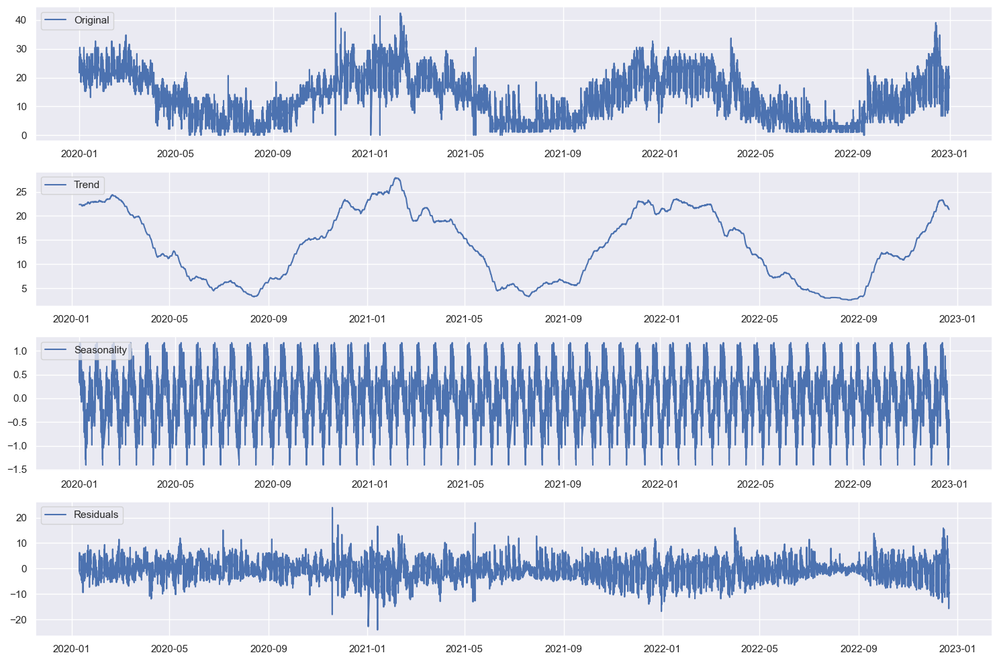

ADF Statistic: -3.403658002335879
p-value: 0.010834800856463853
Meter ID 40752: Optimal number of clusters: 4


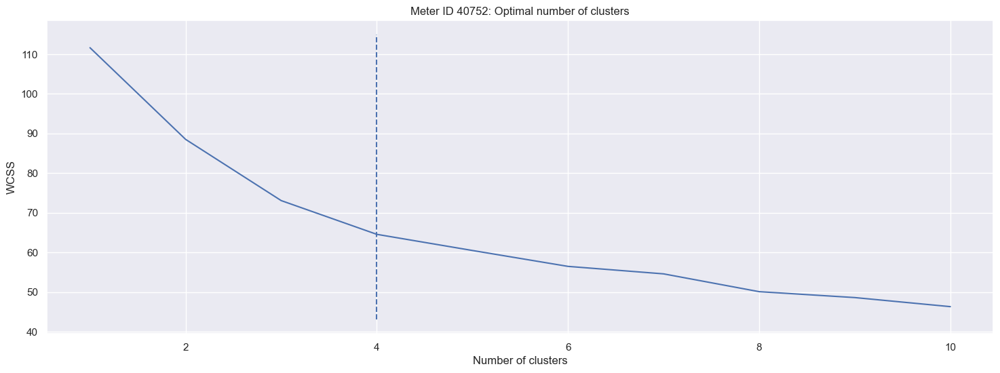

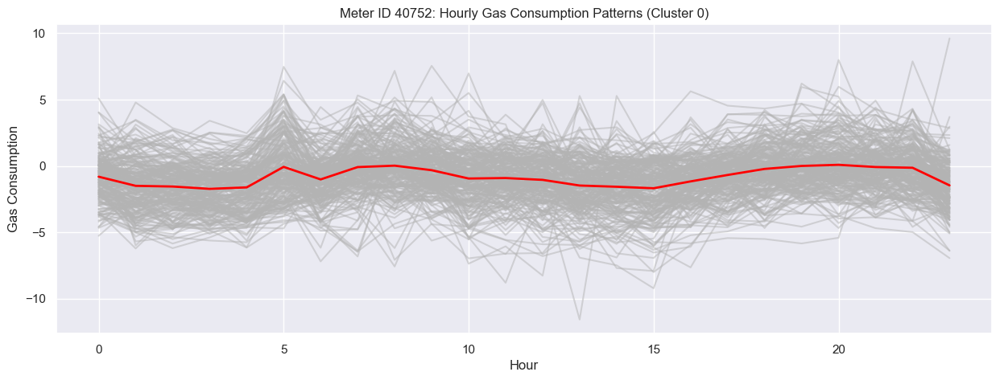

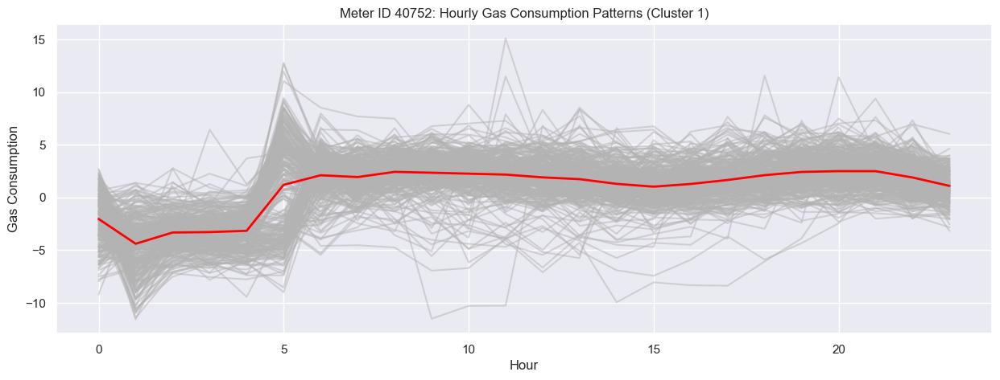

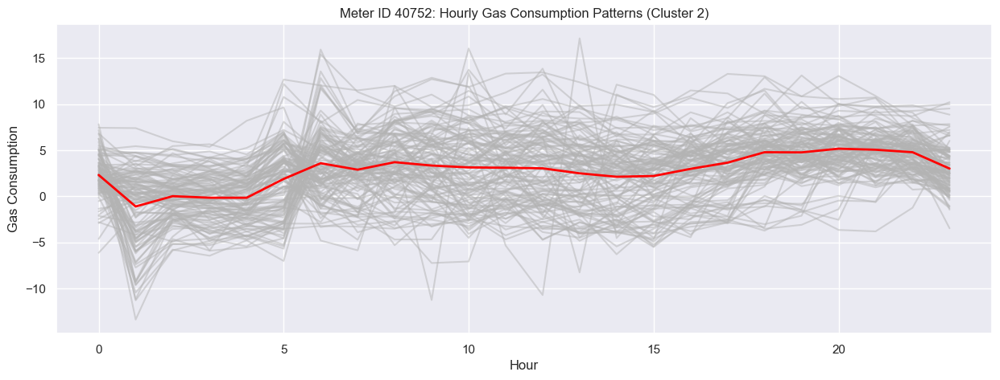

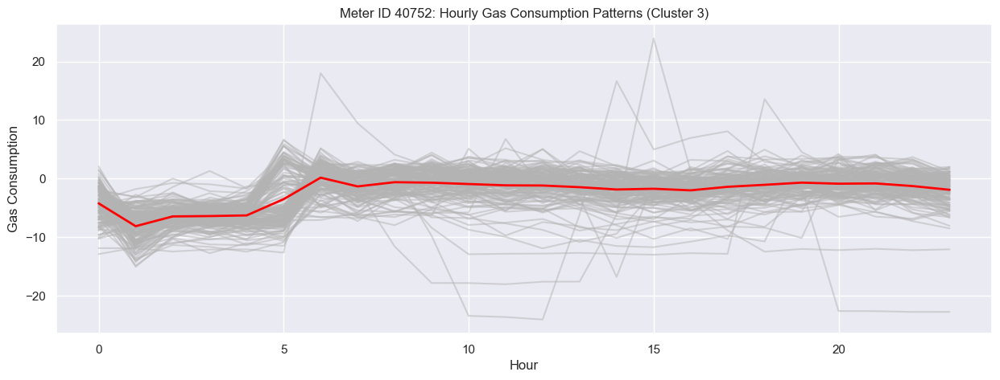

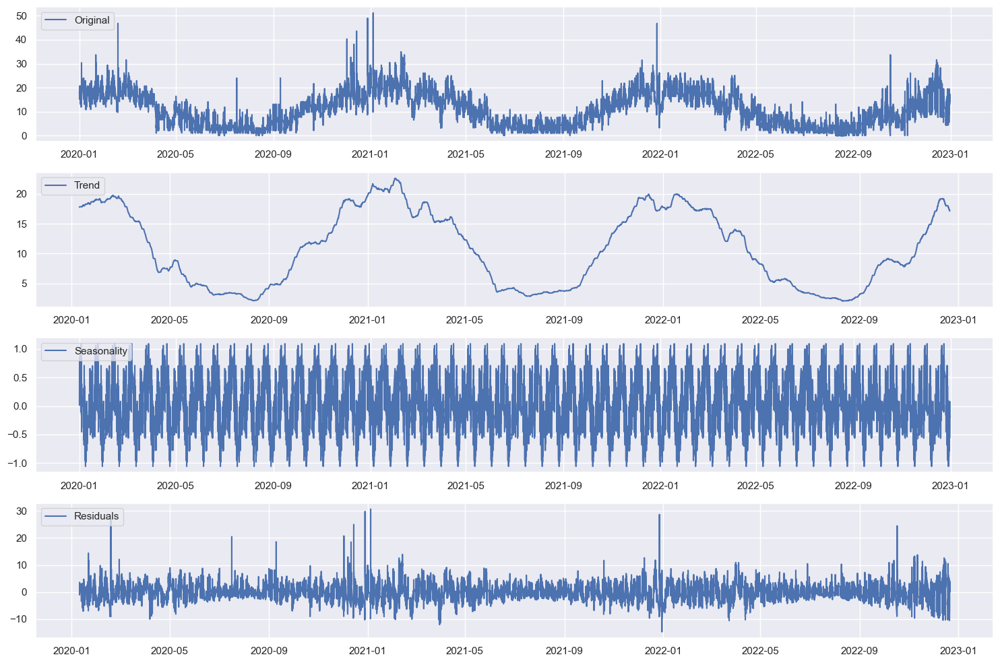

ADF Statistic: -3.1686114612152294
p-value: 0.02187499229805881
Meter ID 40773: Optimal number of clusters: 4


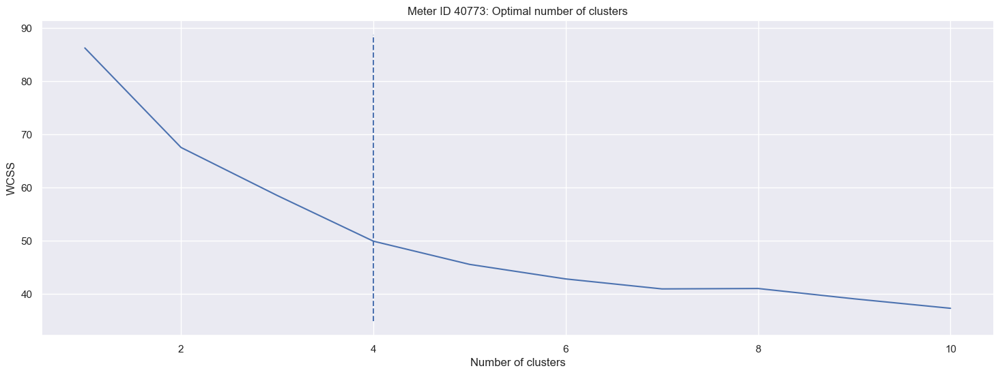

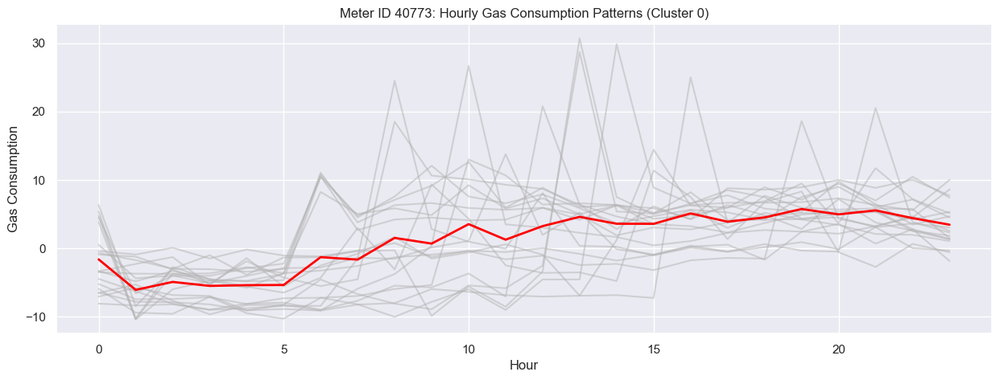

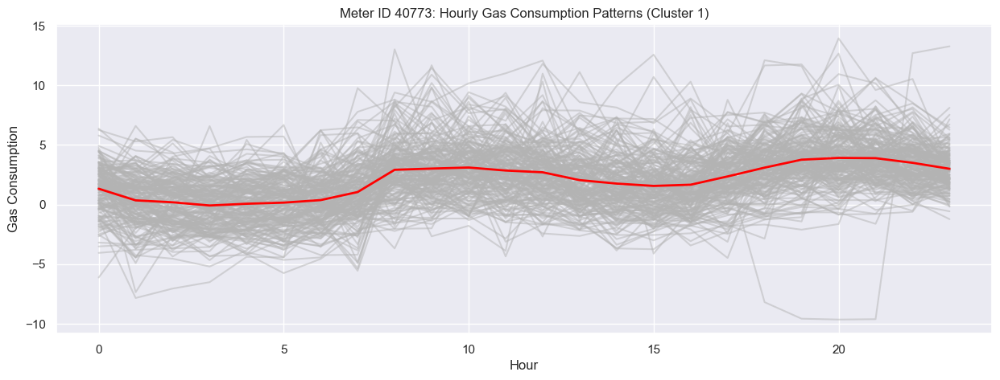

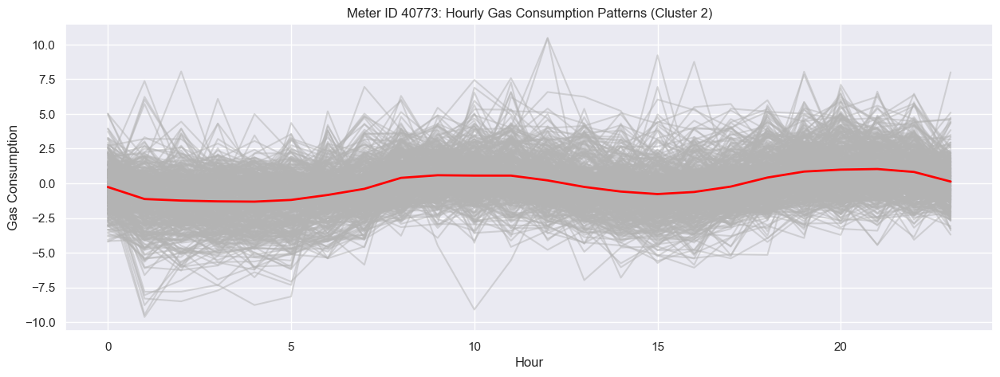

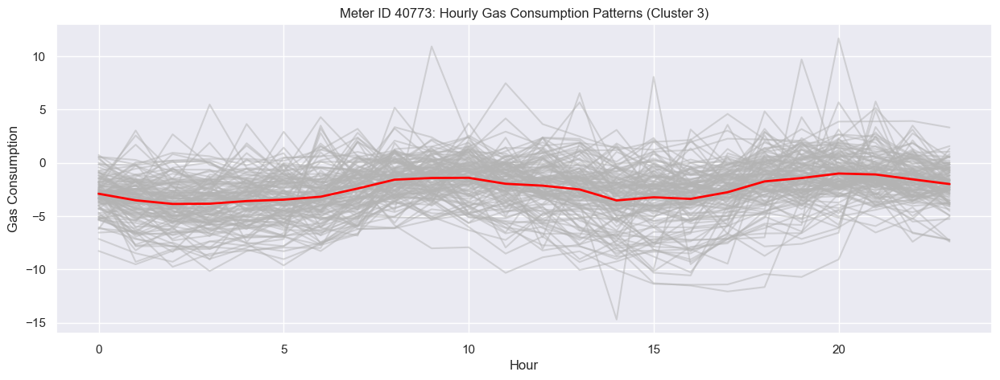

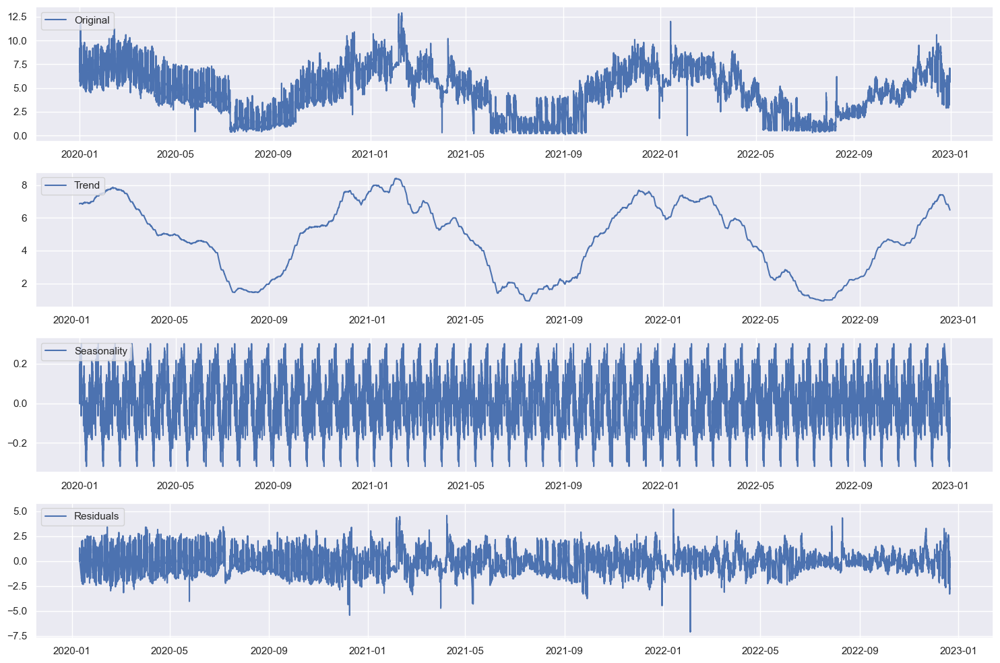

ADF Statistic: -3.1933410718037574
p-value: 0.02037337415983591
Meter ID 40812: Optimal number of clusters: 5


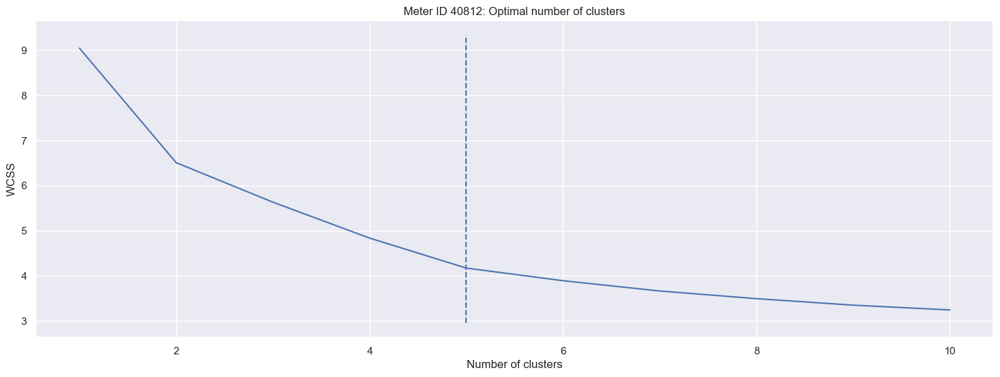

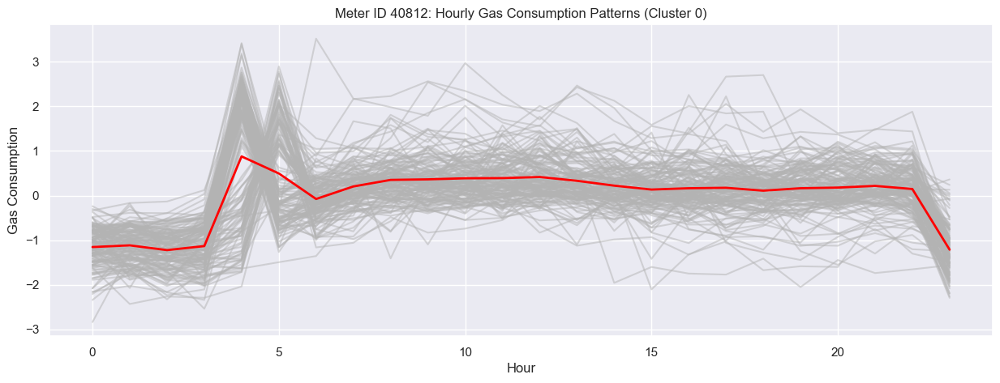

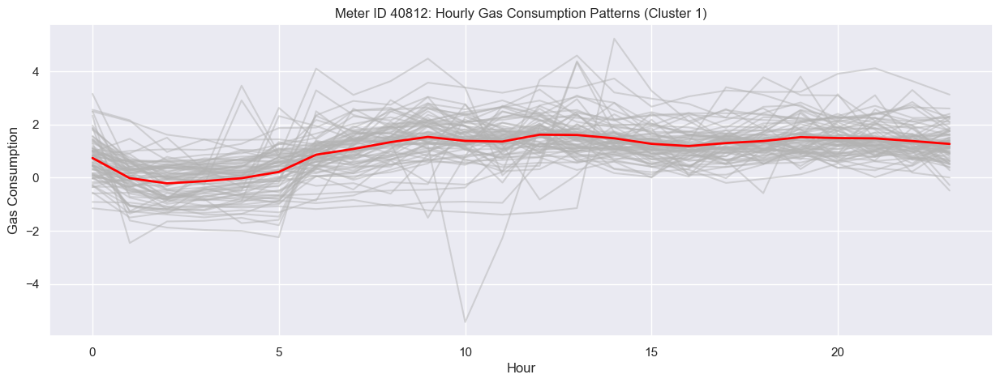

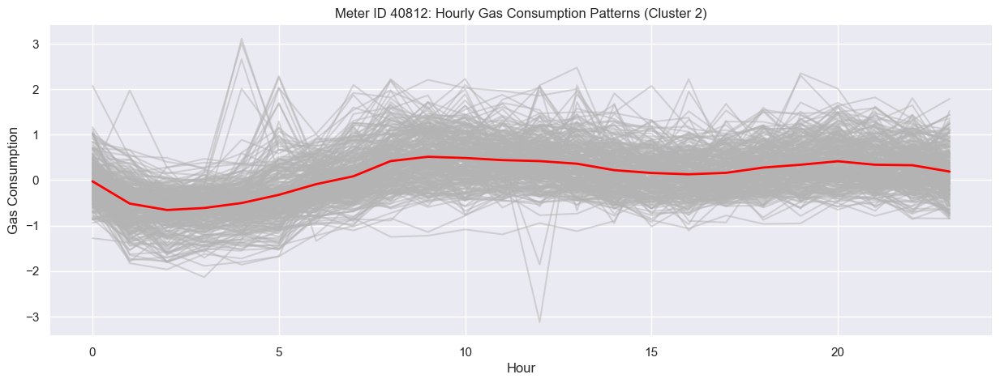

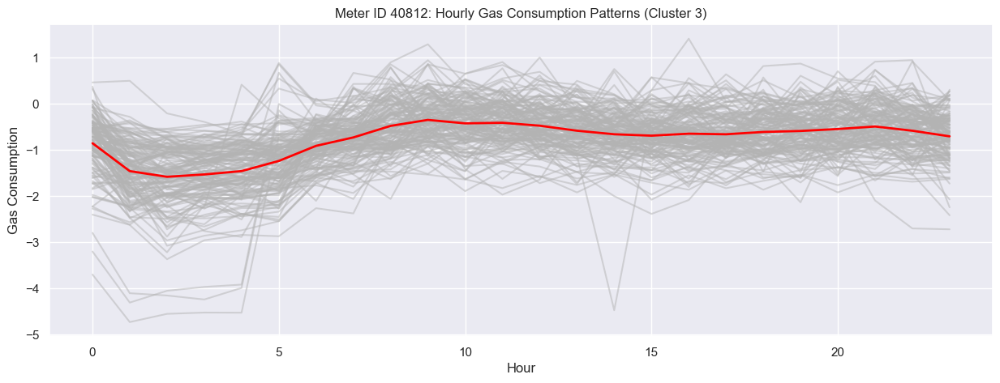

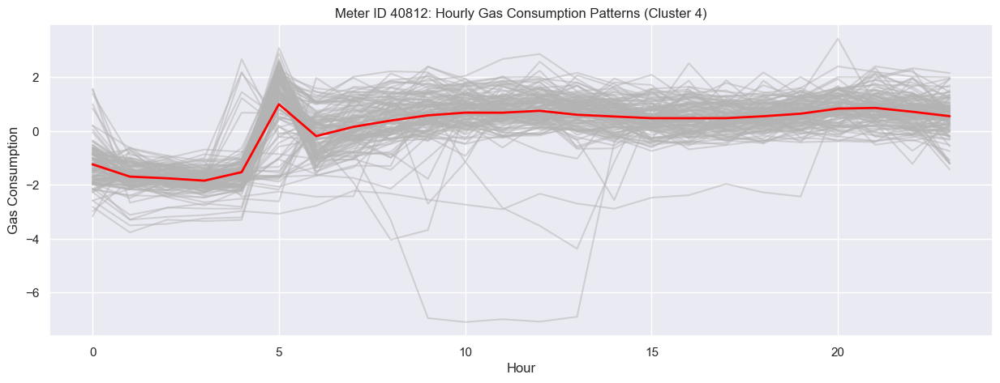

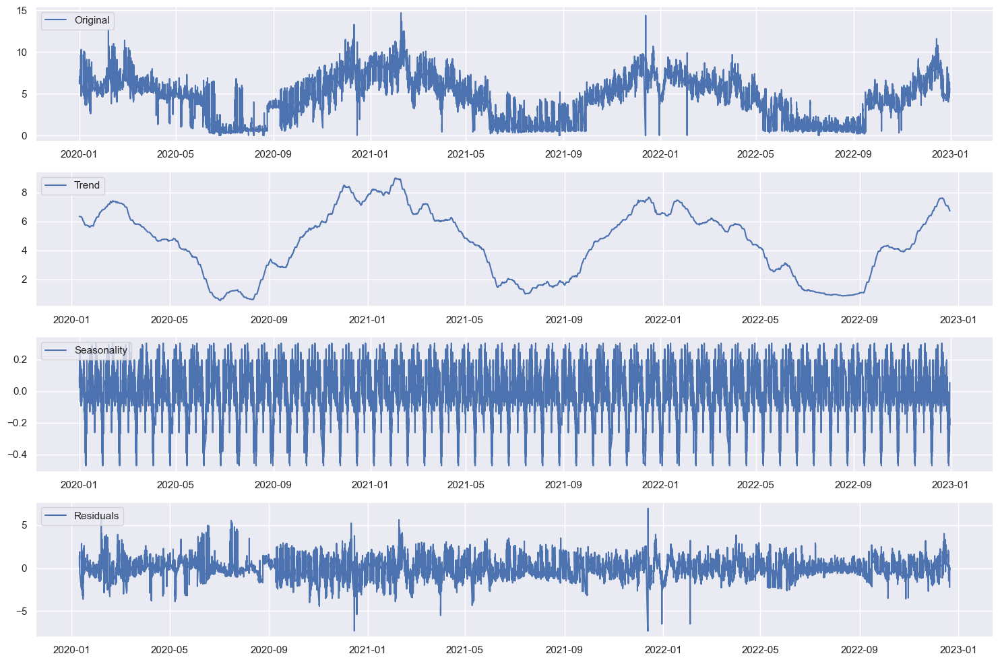

ADF Statistic: -3.430348119024413
p-value: 0.009966800130718411
Meter ID 41574: Optimal number of clusters: 3


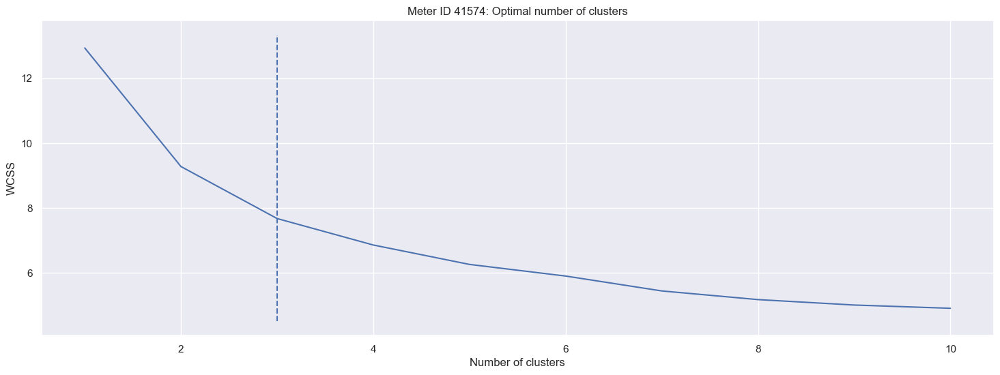

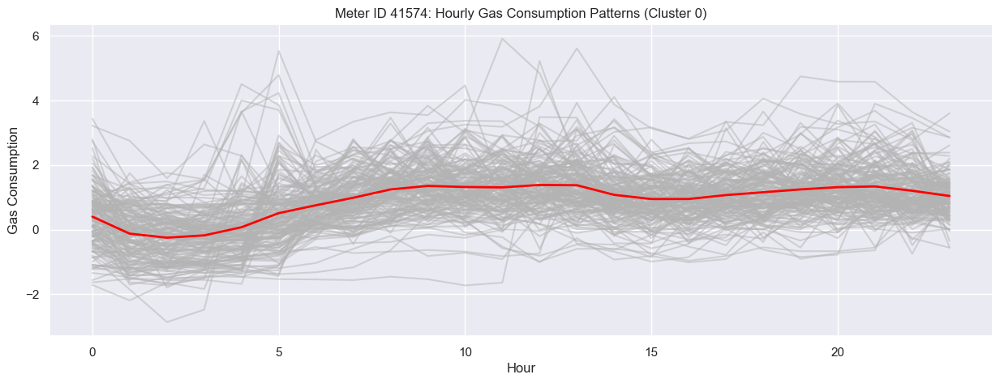

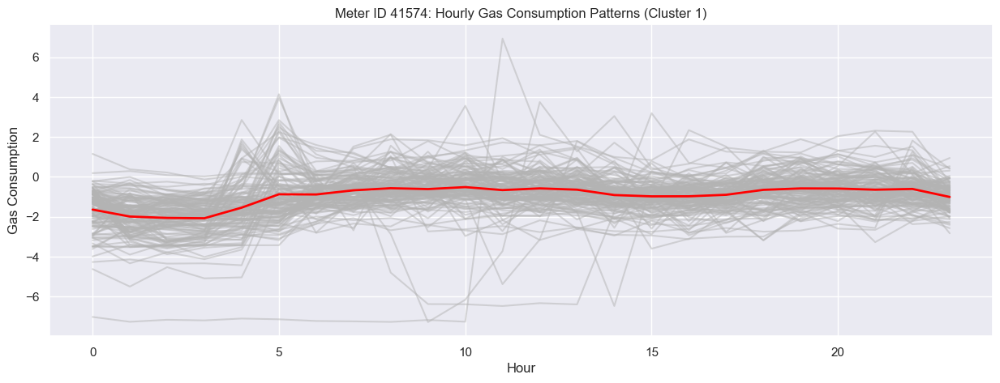

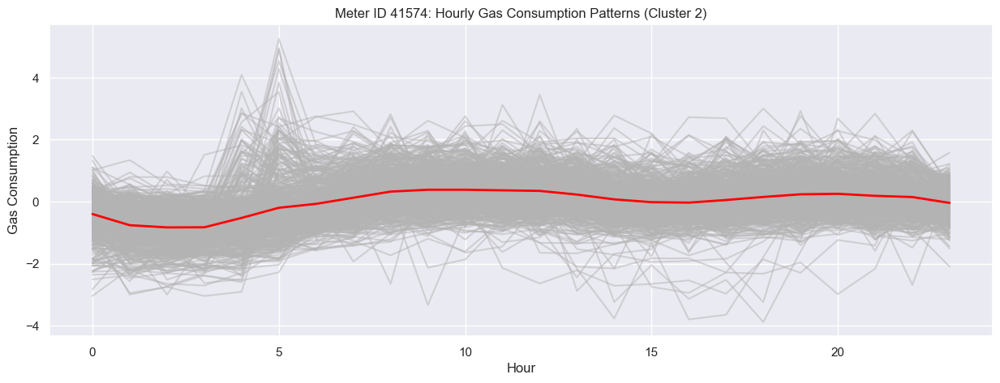

In [334]:
import pandas as pd

clustered_resid_data_exclude_weekends = {}

# 1. Convert 'datetime' column to pandas datetime objects
gas_data['datetime'] = pd.to_datetime(gas_data['datetime'], utc=True)

for meter_id in ids_and_descriptions:
    # 2. Filter out weekend data
    gas_data_weekdays = gas_data[gas_data['datetime'].dt.weekday < 5] 
    
    resid_data = time_series_analysis(gas_data_weekdays, meter_id)
    clustered_data = analyze_and_plot_meter_data_resid(resid_data, meter_id)
    clustered_resid_data_exclude_weekends[meter_id] = clustered_data


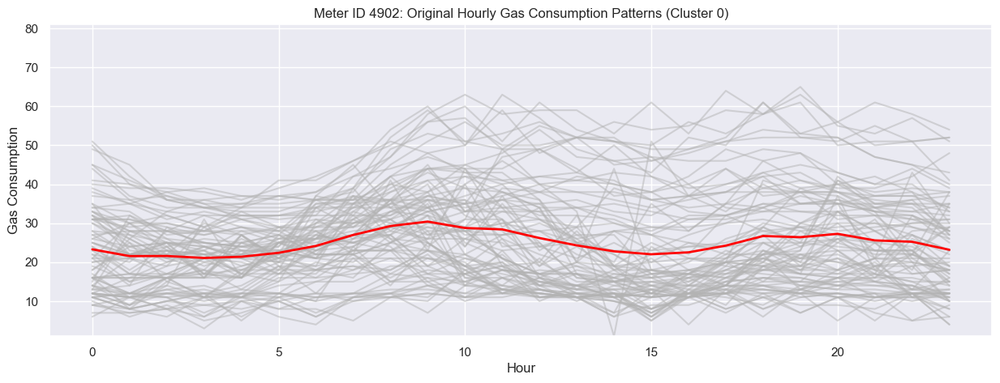

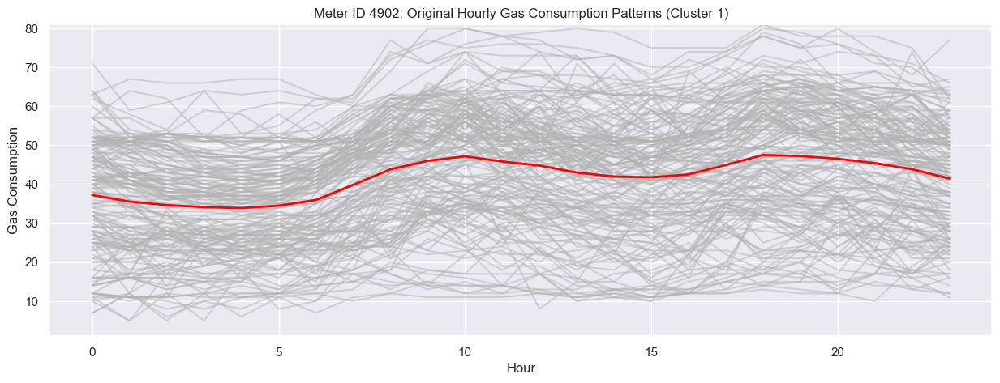

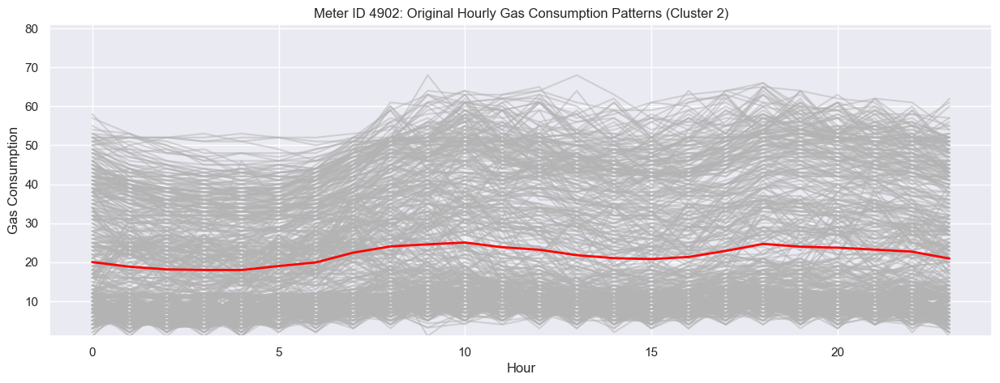

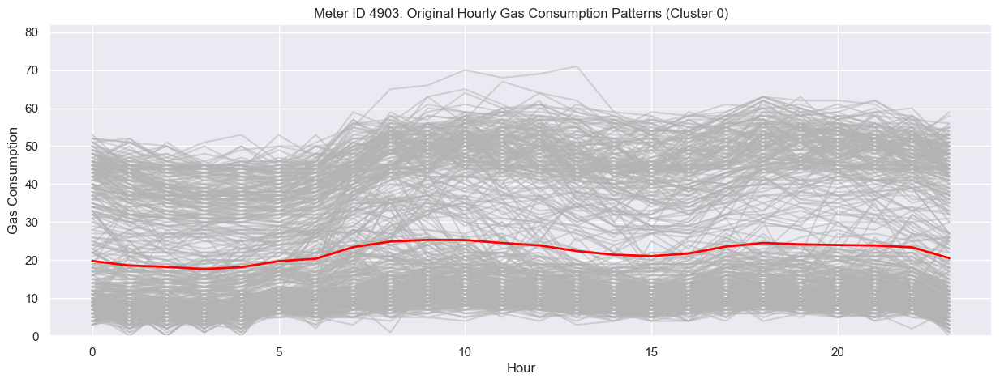

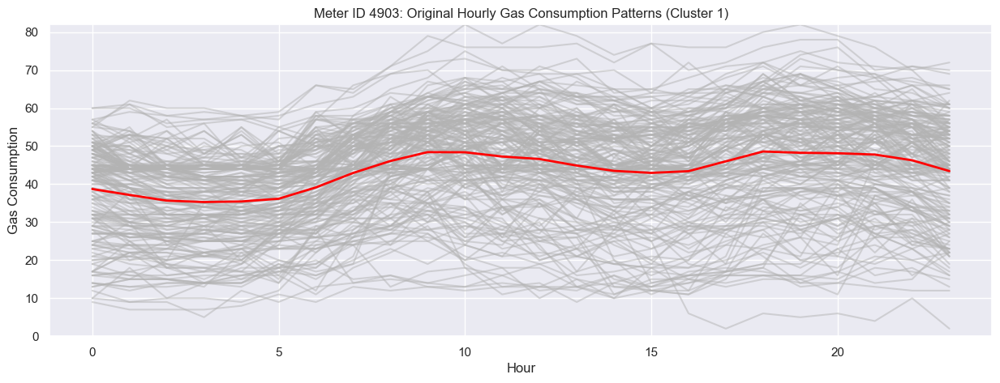

...

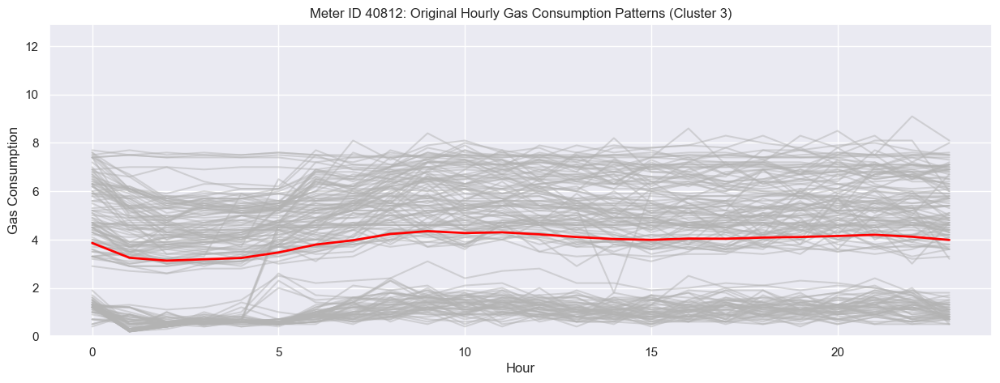

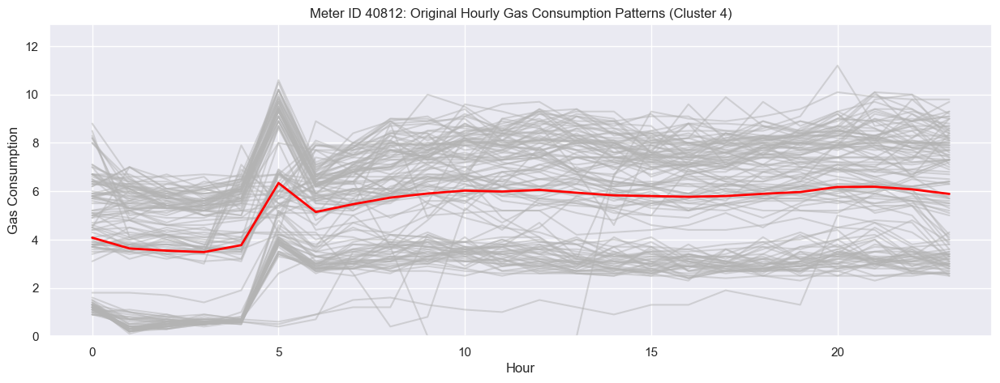

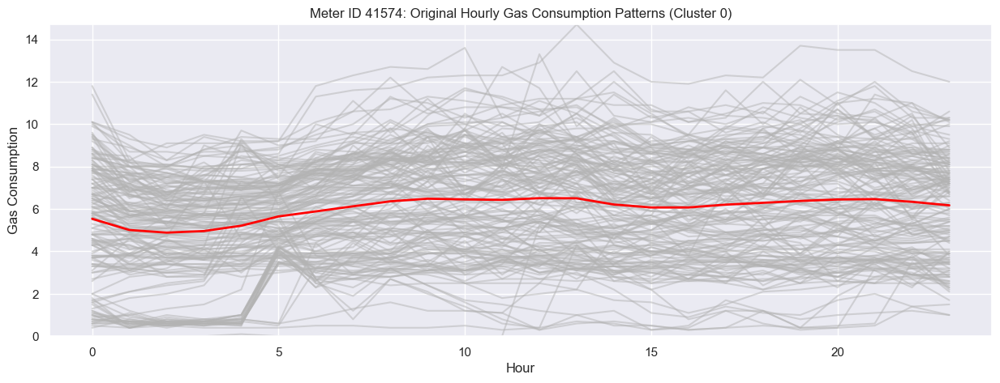

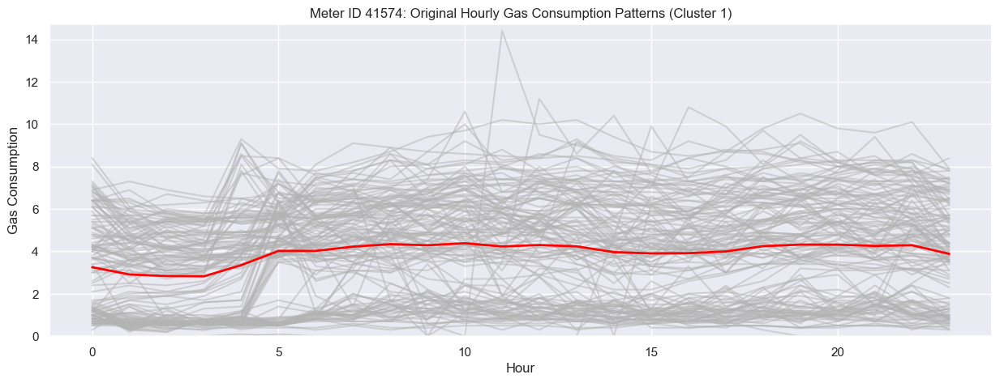

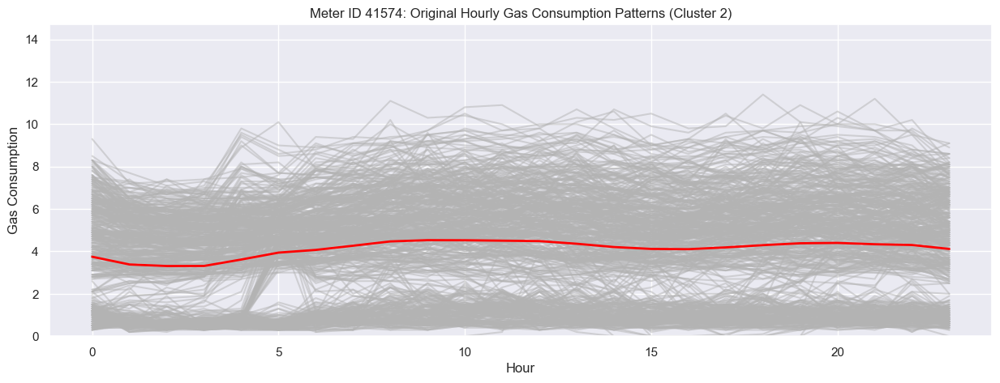

In [340]:
for meter_id in ids_and_descriptions:
    if meter_id in clustered_resid_data_exclude_weekends:
        plot_original_hourly_data(gas_data, meter_id, clustered_resid_data_exclude_weekends)
    else:
        print(f"Meter ID {meter_id} not found in the clustered_resid_data_exclude_weekends dictionary.")


Meter ID 4902:
Optimal number of clusters: 3


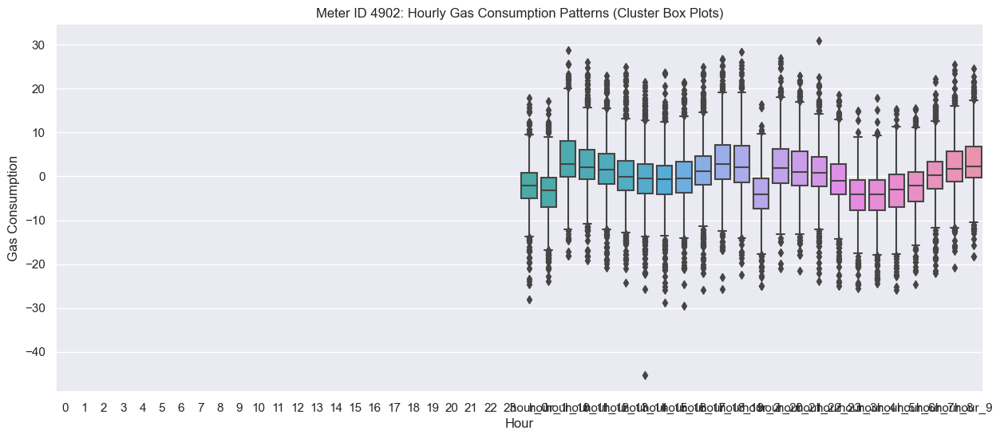



Meter ID 4903:
Optimal number of clusters: 3


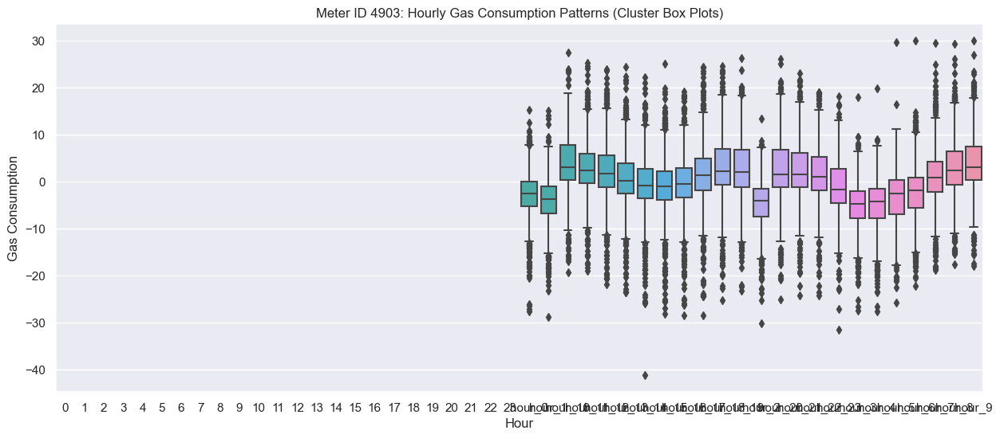



Meter ID 4904:
Optimal number of clusters: 3


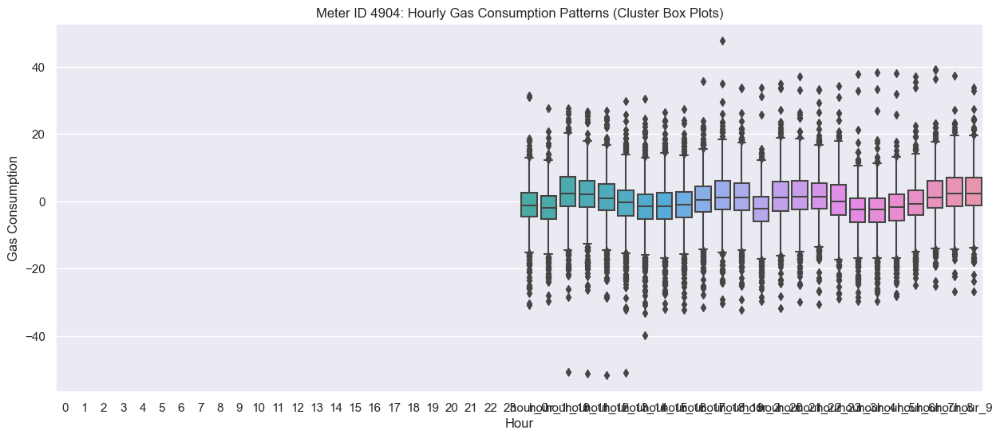



Meter ID 4905:
Optimal number of clusters: 4


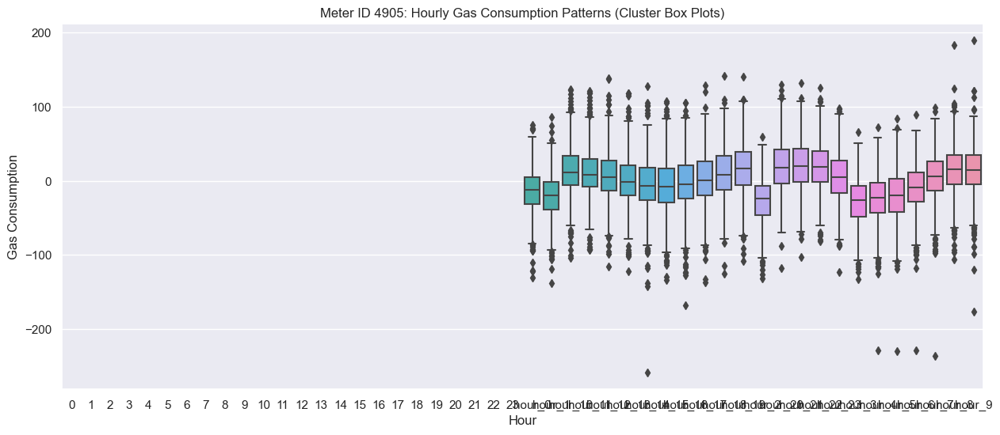



Meter ID 40752:
Optimal number of clusters: 4


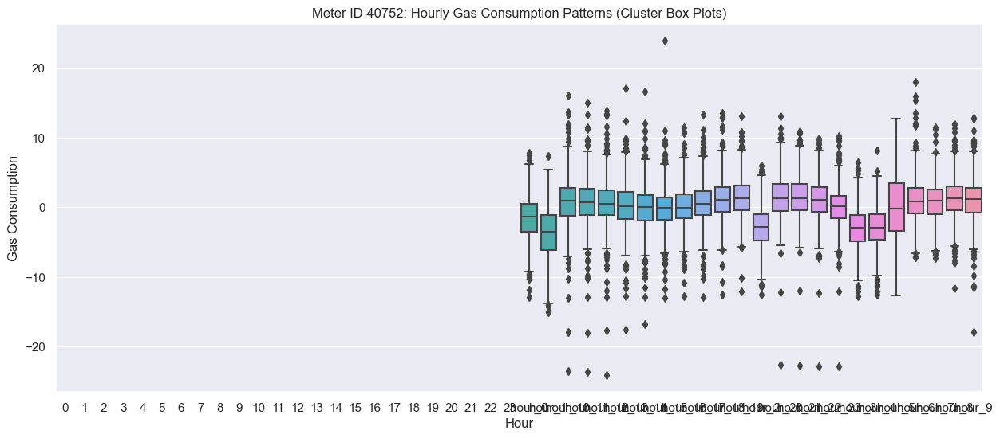



Meter ID 40773:
Optimal number of clusters: 4


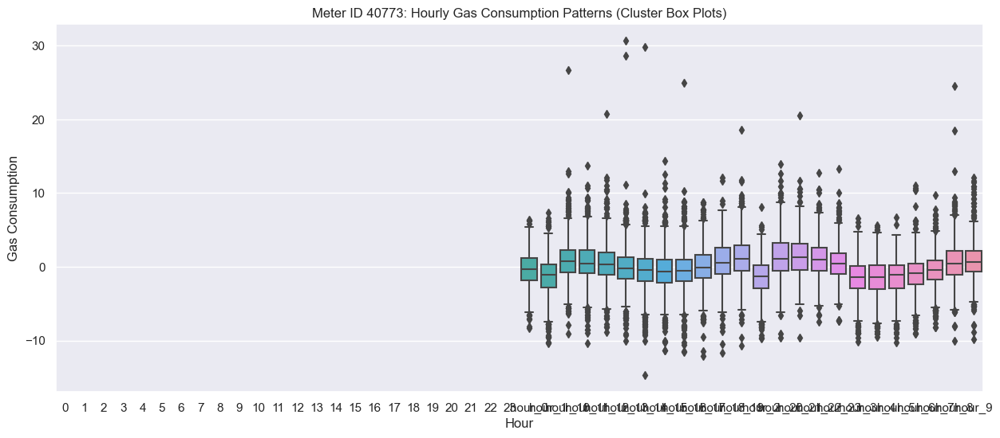



Meter ID 40812:
Optimal number of clusters: 5


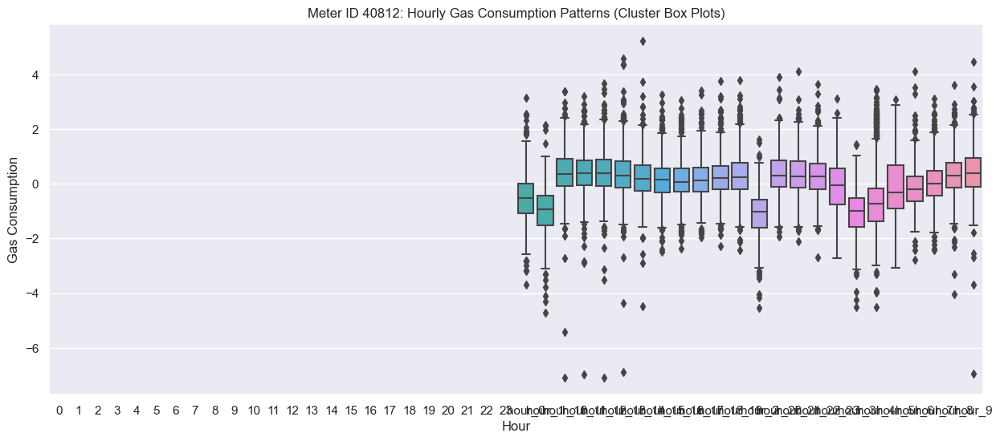



Meter ID 41574:
Optimal number of clusters: 3


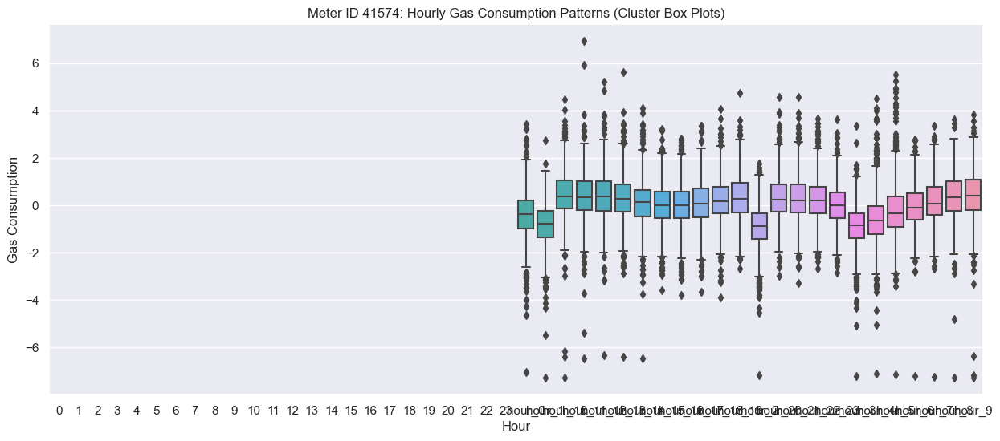

In [328]:
def explore_cluster_results(clustered_resid_data):
    for meter_id, cluster_data in clustered_resid_data.items():
        optimal_k = cluster_data['optimal_k']
        cluster_groups = cluster_data['cluster_groups']
        
        print(f'Meter ID {meter_id}:')
        print(f'Optimal number of clusters: {optimal_k}')
        
#         # 1. Print cluster centroids
#         print("\nCluster Centroids:")
#         for i, cluster_group in cluster_groups.items():
#             cluster_centroid = cluster_group.mean()
#             print(f"Cluster {i}: {cluster_centroid.values}")
        
#         # 2. Calculate descriptive statistics for each cluster
#         print("\nDescriptive Statistics:")
#         for i, cluster_group in cluster_groups.items():
#             cluster_stats = cluster_group.describe()
#             print(f"Cluster {i}:")
#             print(cluster_stats)
        
        # 3. Visualize the clusters using box plots
        cluster_df = pd.DataFrame(columns=range(24))
        for i, cluster_group in cluster_groups.items():
            cluster_df = cluster_df.append(cluster_group)
        
        plt.figure(figsize=(15, 6))
        sns.boxplot(data=cluster_df)
        plt.xlabel("Hour")
        plt.ylabel("Gas Consumption")
        plt.title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Cluster Box Plots)")
        plt.show()
        print("\n" + "=" * 50 + "\n")

# Call the function to explore the cluster results
explore_cluster_results(clustered_resid_data)


In [341]:
!jupyter nbconvert --to html Clustering_remove_seasonality_and_trends.ipynb

[NbConvertApp] Converting notebook Clustering_remove_seasonality_and_trends.ipynb to html
[NbConvertApp] Writing 35052369 bytes to Clustering_remove_seasonality_and_trends.html
